In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas_profiling
import plotly as py
import plotly.offline as pyoff
import plotly.graph_objs as go
import autopep8
#Plotly permet d'avoir des graphes interactifs 
#inititate Plotly
pyoff.init_notebook_mode()

#  <font color=green > Fonctions utilisés </font>

In [2]:
# fonction qui donne le taux de remplissage et nous dit les colonnes vides
# nous renseigne aussi le taux de remplissage
# le taux de valeurs manquantes
def TraceValeurMissing(base):

    col_vides = []
    for col in base.columns:
        if base[col].isnull().all():
          # all Renvoie True si au moins
          # un élément de iterable est vrai. False est renvoyé dans
          # le cas où iterable est vide
            col_vides.append(col)
    print('les colonnes vides sont:\n\n')
    display(col_vides)  # affiche tete de table
    t = pd.DataFrame(index=['number of missing values',
                     'number of values', 'fill_rate'], columns=base.columns)
    for col in base.columns:
        nb_nan = base[col].isnull().sum()
        t.loc['number of missing values', col] = nb_nan
        t.loc['number of values', col] = base.shape[0]-nb_nan
        t.loc['fill_rate', col] = (base.shape[0]-nb_nan)/(base.shape[0]*1.0)
        # taux de remplissage
    display(t)  # pd.set
    dico = {'columns': base.columns, 'fill_rate': (
        t.loc['fill_rate', base.columns]*100), 'missing_values': (100-t.loc['fill_rate', base.columns]*100)}
    tr = pd.DataFrame(dico)
    tr = tr.sort_values(by='fill_rate', ascending=False)  # trier le tableau
    barWidth = 0.85  # largeur des barres
    plt.figure(figsize=(8, 10))
    plt.gca().invert_yaxis()  # pour creer des axes polaires valeur d'une graduation
    # taille des graduations
# plt.barh creation dune barre horizontale
    plt.barh(tr['columns'], tr['fill_rate'], color='#a3acff')
    plt.barh(tr['columns'], tr['missing_values'],
             left=tr['fill_rate'], color='#b5ffb9')
    plt.title('Taux de remplissage', fontsize=30)
    plt.yticks(fontsize=10)
    plt.ylabel('columns', fontdict={'fontsize': 20})
    plt.xlabel('fill rate(%)', fontdict={'fontsize': 20})

    plt.axvline(x=80, color='b')
    plt.text(82, -1, '>80%', color='b')
    plt.axvline(x=20, color='r')
    plt.text(12, -1, '<20%', color='r')
    plt.axvline(x=50, color='g')
    plt.text(50, -1, '>50%', color='b')
    plt.grid(True)

In [3]:
# fonction qui calcule le nombre de pourcentage de valeur manquante
def Missing(Base):
    PVm = ((Base.isnull().sum())/Base.shape[0])*100
    PVm.sort_values(ascending=True)
    return PVm

In [4]:
def Trace_Box(base, quantitative, qualitative):
    # on veut savoir si une variable qualitative va influencer

    plt.figure(figsize=(8, 8))
    ax = sns.boxplot(x=qualitative, y=quantitative,
                     data=base.sort_values([qualitative]))

    plt.show()

In [5]:
def TraceGraphique(Base, colonne):
    plt.figure(figsize=(20, 10))
    sns.boxplot(data=Base, x=colonne)
    plt.title('Dispersion de la variable {}'.format(colonne))
    sns.displot(data=Base, x=colonne, bins=20, kde=True)
    plt.title('Dispersion de la variable {}'.format(colonne))

In [6]:
# fonction qui calcule les outliers ou l'utilisateur choisit son
# ecart 1.5,3 ou 5
# il nous retourne les index les valeurs
# en entree il nous donne le nom de la colonne
def CalculOutlier(v):
    ecart = input('Donnez votre écart = ')
    ecart = float(ecart)  # conversion de ecart en float
    # cette fonction nous donne les index et valeurs des valeurs aberrantes
    # le nom de la colonne
    Q1 = v.quantile(0.25)
    Q3 = v.quantile(0.75)
    EIQ = Q3-Q1
    LI = Q1-ecart*EIQ
    LS = Q3+ecart*EIQ
    i = list(v.index[(v < LI) | (v > LS)])
    val = list(v[i])
    print('Voila votre résultat pour un ecart interquartile de {}'.format(ecart))
    return i, val

In [7]:
# fonction qui permet de choisir une base la colonne qui nous dit le nombre
# de doublons et qui les supprimes
def Doublons(Base, colonne):
    d = Base.duplicated(subset=colonne).sum()
    print('Vous avez {} doublons pour cette variable {}'.format(d, colonne))
    lignes = Base.shape[0]-d
    NBase = Base.drop_duplicates(subset=colonne)
    print('Il vous restent {} lignes de votre Dataframe'.format(lignes))
    return NBase

In [8]:
# fonction qui trace le graphique des eboulis des valeurs propres
def display_scree_plot(pca):
    scree = pca.explained_variance_ratio_*100
    plt.bar(np.arange(len(scree))+1, scree)
    plt.plot(np.arange(len(scree))+1, scree.cumsum(), c="red", marker='o')
    plt.xlabel("rang de l'axe d'inertie")
    plt.ylabel("pourcentage d'inertie")
    plt.title("Eboulis des valeurs propres")
    plt.show(block=False)

In [9]:
# fonction qui trace les cercle de corrélations
#
def display_circles(pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None):
    for d1, d2 in axis_ranks:  # On affiche les 3 premiers plans factoriels, donc les 6 premières composantes
        if d2 < n_comp:

            # initialisation de la figure
            fig, ax = plt.subplots(figsize=(7, 6))

            # détermination des limites du graphique
            if lims is not None:
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30:
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else:
                xmin, xmax, ymin, ymax = min(pcs[d1, :]), max(
                    pcs[d1, :]), min(pcs[d2, :]), max(pcs[d2, :])

            # affichage des flèches
            # s'il y a plus de 30 flèches, on n'affiche pas le triangle à leur extrémité
            if pcs.shape[1] < 30:
                plt.quiver(np.zeros(pcs.shape[1]), np.zeros(pcs.shape[1]),
                           pcs[d1, :], pcs[d2, :],
                           angles='xy', scale_units='xy', scale=1, color="grey")
                # (voir la doc : https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html)
            else:
                lines = [[[0, 0], [x, y]] for x, y in pcs[[d1, d2]].T]
                ax.add_collection(LineCollection(
                    lines, axes=ax, alpha=.1, color='black'))

            # affichage des noms des variables
            if labels is not None:
                for i, (x, y) in enumerate(pcs[[d1, d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax:
                        plt.text(x, y, labels[i], fontsize='14', ha='center',
                                 va='center', rotation=label_rotation, color="blue", alpha=0.5)

            # affichage du cercle
            circle = plt.Circle((0, 0), 1, facecolor='none', edgecolor='b')
            plt.gca().add_artist(circle)
            plt.axis('square')

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)

            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-1, 1], color='grey', ls='--')

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('F{} ({}%)'.format(
                d1+1, round(100*pca.explained_variance_ratio_[d1], 1)))
            plt.ylabel('F{} ({}%)'.format(
                d2+1, round(100*pca.explained_variance_ratio_[d2], 1)))

            plt.title("Cercle des corrélations (F{} et F{})".format(d1+1, d2+1))
            plt.show(block=False)

In [10]:
# fonction qui trace le graphique des individus selon
# les plans factoriels
def display_factorial_planes(X_projected, n_comp, pca, axis_ranks, labels=None, alpha=1, illustrative_var=None):
    for d1, d2 in axis_ranks:
        if d2 < n_comp:

            # initialisation de la figure
            fig = plt.figure(figsize=(7, 6))

            # affichage des points
            if illustrative_var is None:
                plt.scatter(X_projected[:, d1],
                            X_projected[:, d2], alpha=alpha)
            else:
                illustrative_var = np.array(illustrative_var)
                for value in np.unique(illustrative_var):
                    selected = np.where(illustrative_var == value)
                    plt.scatter(
                        X_projected[selected, d1], X_projected[selected, d2], alpha=alpha, label=value)
                plt.legend()

            # affichage des labels des points
            if labels is not None:
                for i, (x, y) in enumerate(X_projected[:, [d1, d2]]):
                    plt.text(x, y, labels[i],
                             fontsize='14', ha='center', va='center')

            # détermination des limites du graphique
            boundary = np.max(np.abs(X_projected[:, [d1, d2]])) * 1.1
            plt.xlim([-boundary, boundary])
            plt.ylim([-boundary, boundary])

            # affichage des lignes horizontales et verticales
            plt.plot([-100, 100], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-100, 100], color='grey', ls='--')

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('F{} ({}%)'.format(
                d1+1, round(100*pca.explained_variance_ratio_[d1], 1)))
            plt.ylabel('F{} ({}%)'.format(
                d2+1, round(100*pca.explained_variance_ratio_[d2], 1)))

            plt.title(
                "Projection des individus (sur F{} et F{})".format(d1+1, d2+1))
            plt.show(block=False)

# <font color=grenn > Importation table et études  </font>

In [11]:
data=pd.read_csv('BaseNettoye.csv',index_col=0)

In [3]:
data.head()

,customer_id,customer_unique_id,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,Délai_livraison,order_item_id,product_id,price,freight_value,product_category_name_english,payment_sequential,payment_type,payment_installments,payment_value,review_score
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-25 10:35:35,8 days 19:30:00,1.0,a9516a079e37a9c9c36b9b78b10169e8,124.99,21.88,OFFICE,1.0,credit_card,2.0,146.87,4
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-29 12:41:19,16 days 15:52:55,1.0,4aa6014eceb682077f9dc4bffebc05b0,289.00,46.48,APPLIANCES,1.0,credit_card,8.0,335.48,5
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-06-14 17:58:51,26 days 01:51:06,1.0,bd07b66896d6f1494f5b86251848ced7,139.94,17.79,OFFICE,1.0,credit_card,7.0,157.73,5
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-28 16:04:25,14 days 23:57:47,1.0,a5647c44af977b148e0a3a4751a09e2e,149.94,23.36,OFFICE,1.0,credit_card,1.0,173.30,5
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-08-09 20:55:48,11 days 11:04:18,1.0,9391a573abe00141c56e38d84d7d5b3b,230.00,22.25,HOME,1.0,credit_card,8.0,252.25,5


In [12]:
data.shape

(114063, 19)

## <font color=grenn > Missing </font>

les colonnes vides sont:




[]

,customer_id,customer_unique_id,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,Délai_livraison,order_item_id,product_id,price,freight_value,product_category_name_english,payment_sequential,payment_type,payment_installments,payment_value,review_score
number of missing values,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
number of values,114063,114063,114063,114063,114063,114063,114063,114063,114063,114063,114063,114063,114063,114063,114063,114063,114063,114063,114063
fill_rate,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


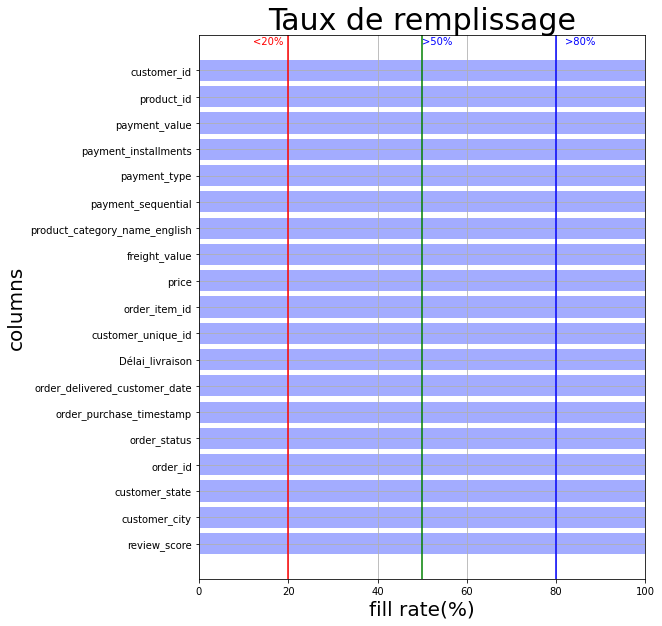

In [14]:
TraceValeurMissing(data)

In [12]:
data.dtypes

customer_id                       object
customer_unique_id                object
customer_city                     object
customer_state                    object
order_id                          object
order_status                      object
order_purchase_timestamp          object
order_delivered_customer_date     object
Délai_livraison                   object
order_item_id                    float64
product_id                        object
price                            float64
freight_value                    float64
product_category_name_english     object
payment_sequential               float64
payment_type                      object
payment_installments             float64
payment_value                    float64
review_score                       int64
dtype: object

In [13]:
data.shape

(114063, 19)

## <font color=grenn > Graphique </font>

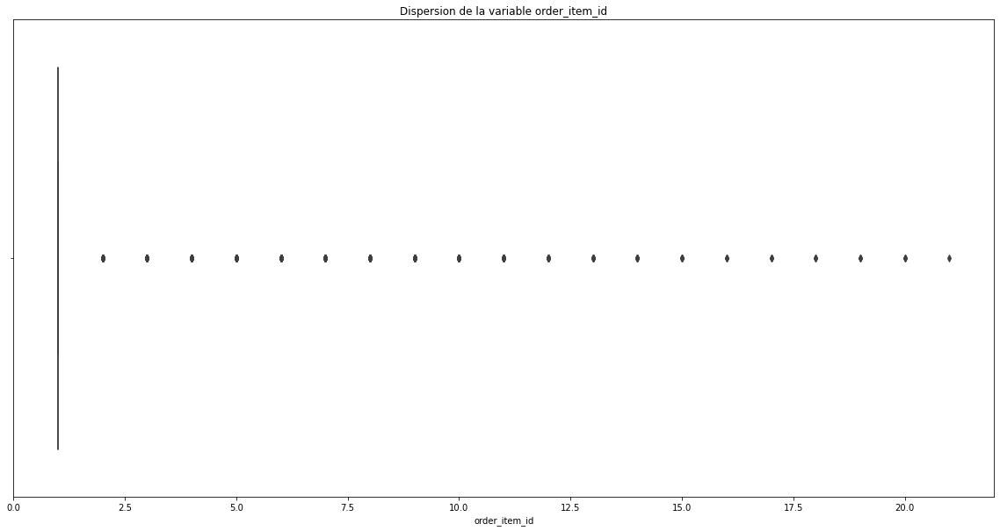

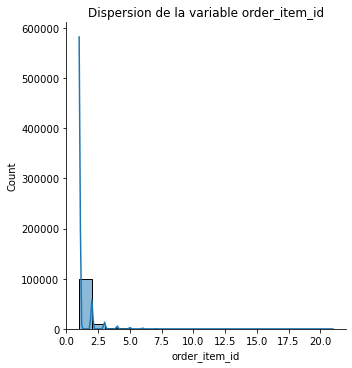

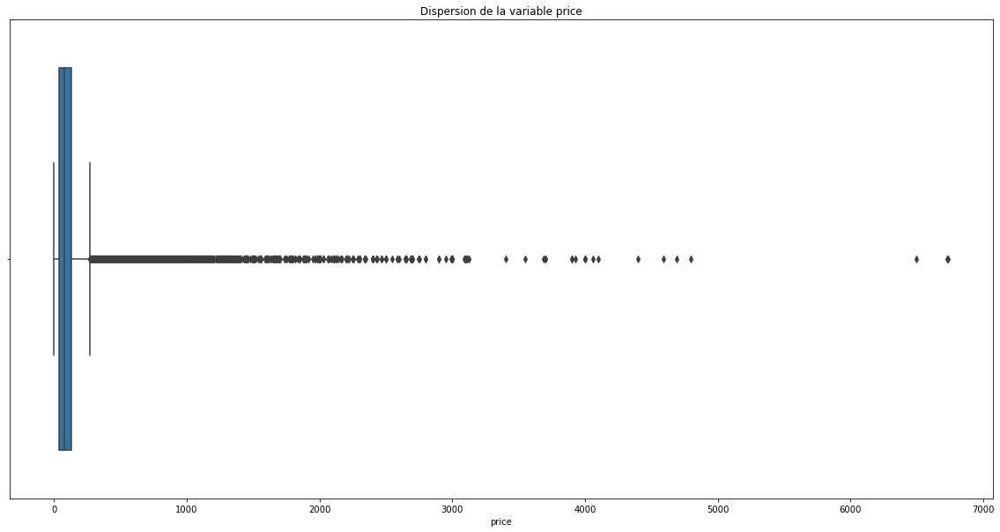

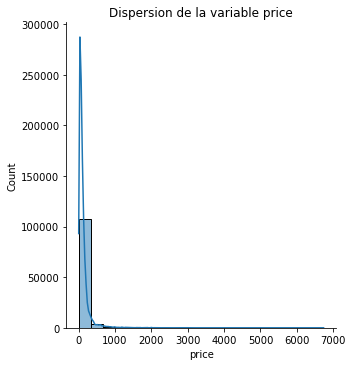

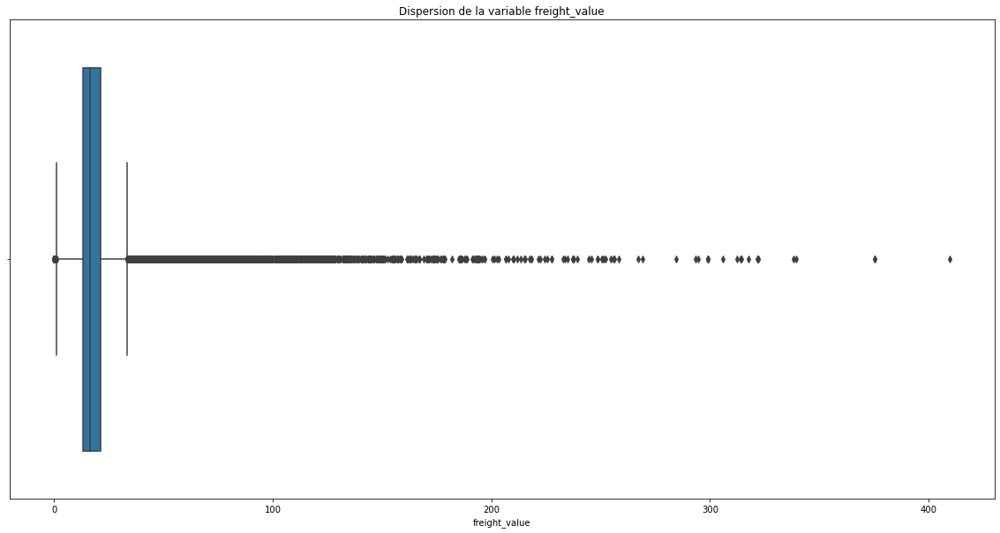

...

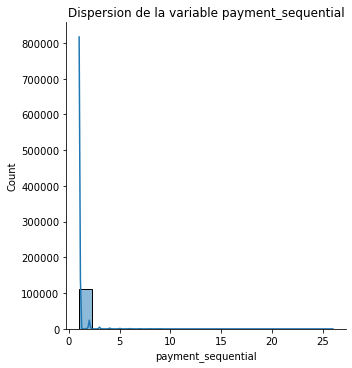

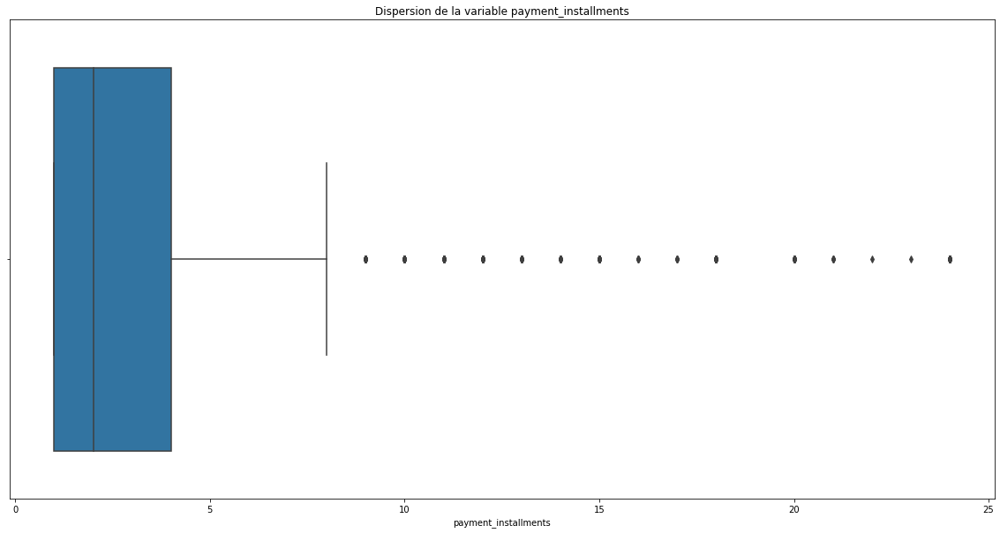

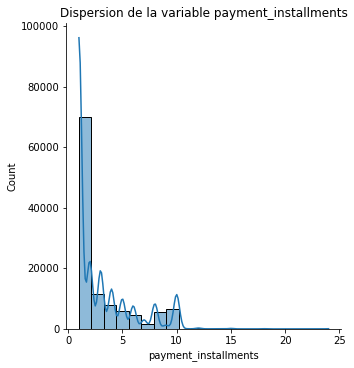

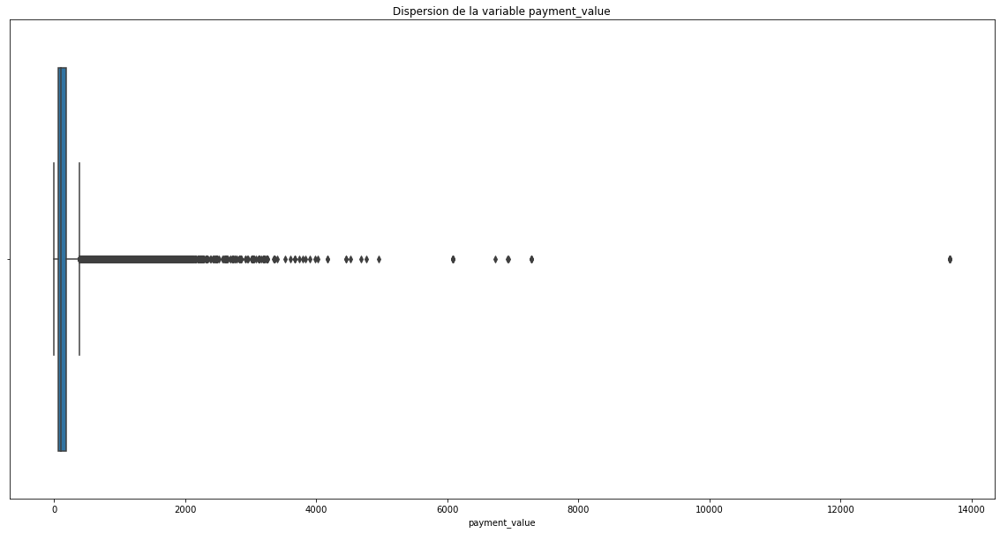

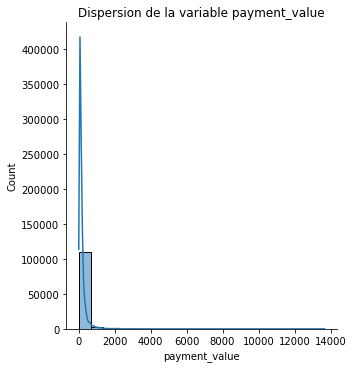

In [19]:
for col in data.select_dtypes(['float64']).columns:
    TraceGraphique(data,col)

## <font color=grenn > Exploration </font>

In [20]:
data.describe()

,order_item_id,price,freight_value,payment_sequential,payment_installments,payment_value,review_score
count,114063.000000,114063.000000,114063.000000,114063.000000,114063.000000,114063.00000,114063.000000
mean,1.197487,119.999146,20.010193,1.090494,2.946451,172.12434,4.067384
std,0.703143,182.349686,15.726501,0.684495,2.781652,266.08983,1.357693
min,1.000000,0.850000,0.000000,1.000000,1.000000,0.00000,1.000000
25%,1.000000,39.900000,13.080000,1.000000,1.000000,60.96000,4.000000
50%,1.000000,74.900000,16.320000,1.000000,2.000000,108.07000,5.000000
75%,1.000000,133.000000,21.190000,1.000000,4.000000,189.37000,5.000000
max,21.000000,6735.000000,409.680000,26.000000,24.000000,13664.08000,5.000000


In [281]:
data.dtypes

customer_id                       object
customer_unique_id                object
customer_city                     object
customer_state                    object
order_id                          object
order_status                      object
order_purchase_timestamp          object
order_delivered_customer_date     object
Délai_livraison                   object
order_item_id                    float64
product_id                        object
price                            float64
freight_value                    float64
product_category_name_english     object
payment_sequential               float64
payment_type                      object
payment_installments             float64
payment_value                    float64
review_score                       int64
dtype: object

<AxesSubplot:>

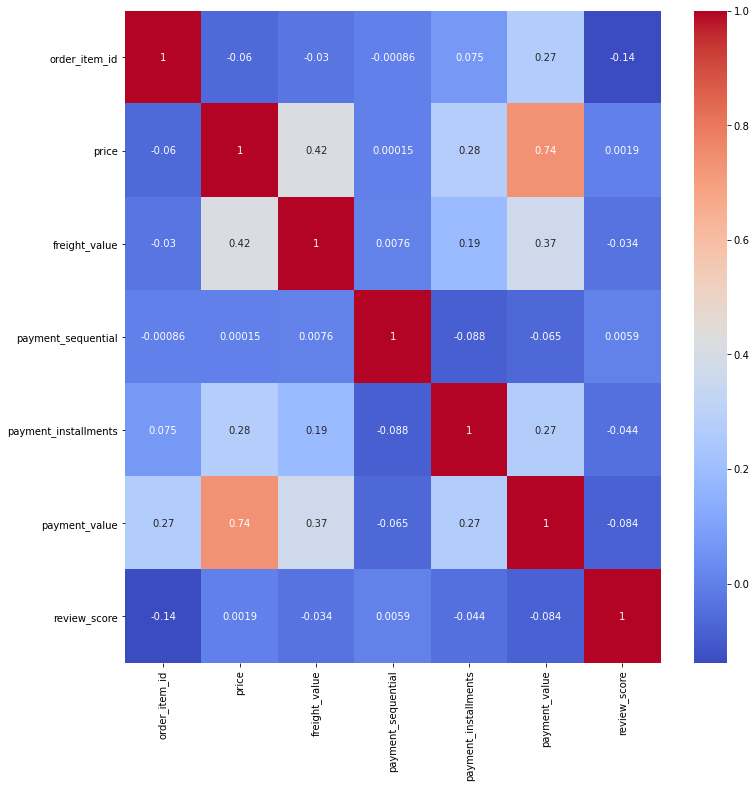

In [282]:
cor=data.corr()
fig,ax=plt.subplots(figsize=(12,12))
sns.heatmap(cor,annot=True,ax=ax,cmap='coolwarm')
#la corrrélation entre le prix d'un article et le paiement est de 0.73

## <font color=grenn > Transformation des types </font>

In [13]:
data['order_purchase_timestamp']=pd.to_datetime(data['order_purchase_timestamp'])

In [14]:
data['order_delivered_customer_date']=pd.to_datetime(data['order_delivered_customer_date'])

In [15]:
data['Durée_livraison']=data['order_delivered_customer_date']-data['order_purchase_timestamp']

In [16]:
data['Durée_livraison']=data['Durée_livraison'].apply(lambda x: x.days)
#data['Durée_livraison'].dt.days on peut utiliser cette technique

In [17]:
data=data.drop(columns=['Délai_livraison'])

In [9]:
data['Durée_livraison'].head()

0     8
1    16
2    26
3    14
4    11
Name: Durée_livraison, dtype: int64

In [10]:
data.shape

(114063, 19)

# <font color=grenn > Création features   </font>

## Montant de lachat 

In [18]:
#le prix qu'un client paye lors de sa commande 
data['Montant_achat']=(data['price']*data['order_item_id'])+(data['freight_value']*data['order_item_id'])

## Prix livraison du produit

In [19]:
#le prix de la livraison que le client paye 
data['Prix_Livraison']=(data['freight_value']*data['order_item_id'])

## Prix produit

In [20]:
#le prix que le client paye avec  le nombre de produits quil a commande 
data['Prix_produit']=(data['price']*data['order_item_id'])

## Rapport livraison et prix

In [21]:
data['Rapport_liv_prod']=data['Prix_Livraison']/data['Prix_produit']
data['Rapport_liv_prod'].describe()

count    114063.000000
mean          0.321823
std           0.347101
min           0.000000
25%           0.135111
50%           0.232475
75%           0.394057
max          26.235294
Name: Rapport_liv_prod, dtype: float64

## Analyse exploratoire

In [24]:
data['Montant_achat'].describe()

count    114063.000000
mean        159.574288
std         226.463707
min           6.080000
25%          61.100000
50%         103.040000
75%         175.640000
max       13664.080000
Name: Montant_achat, dtype: float64

In [25]:
data['Prix_Livraison'].describe()

count    114063.000000
mean         23.624966
std          24.908720
min           0.000000
25%          13.750000
50%          17.320000
75%          24.970000
max        1794.960000
Name: Prix_Livraison, dtype: float64

In [26]:
i=data['Prix_Livraison']==1794.960000
data[i]

,customer_id,customer_unique_id,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,...,payment_sequential,payment_type,payment_installments,payment_value,review_score,Durée_livraison,Montant_achat,Prix_Livraison,Prix_produit,Rapport_liv_prod
57967,ed583a2a1eaf0dedc33af816153e8b8c,fff5eb4918b2bf4b2da476788d42051c,campina grande,PB,cf4659487be50c0c317cff3564c4a840,delivered,2018-07-02 16:39:59,2018-07-16 11:12:52,6.0,bc3c6d2a621414f2e1df7a8a32a2828e,...,1.0,boleto,1.0,2844.96,5,13,2844.96,1794.96,1050.0,1.709486


In [29]:
data['Prix_produit'].describe()

count    114063.000000
mean        135.949322
std         215.473724
min           0.850000
25%          45.000000
50%          83.490000
75%         149.900000
max       13440.000000
Name: Prix_produit, dtype: float64

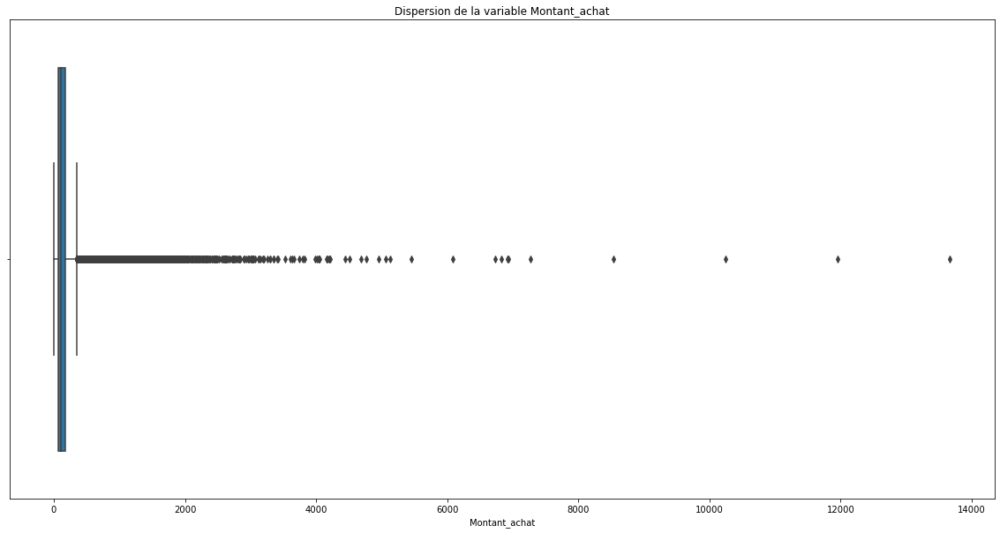

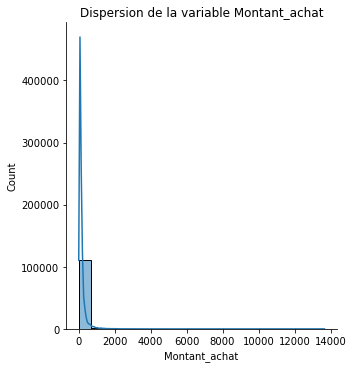

In [36]:
TraceGraphique(data,'Montant_achat')

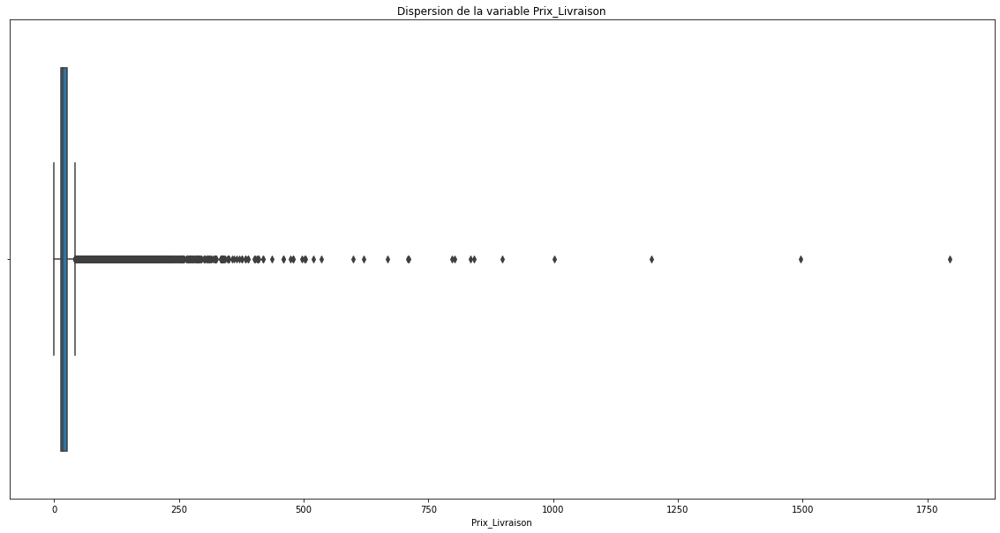

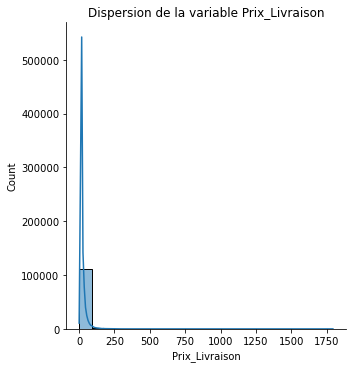

In [40]:
TraceGraphique(data,'Prix_Livraison')

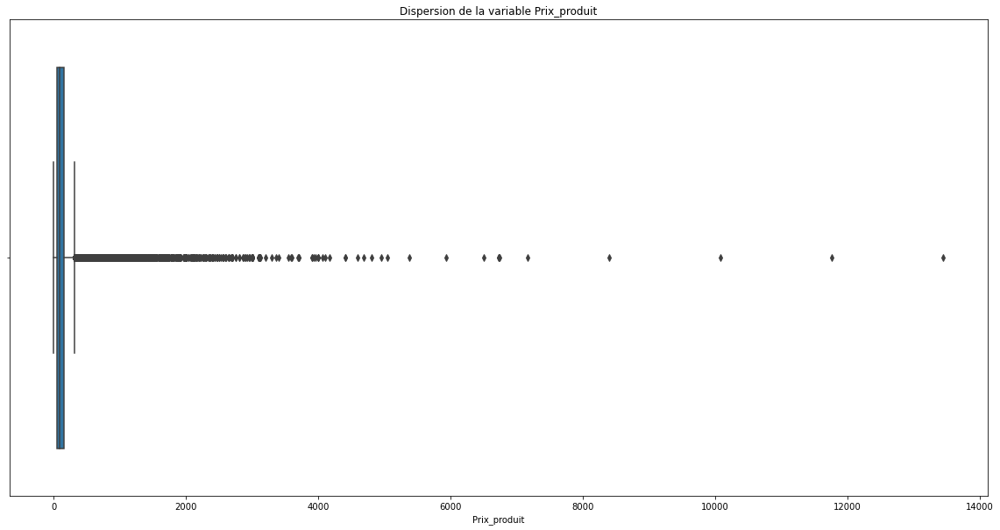

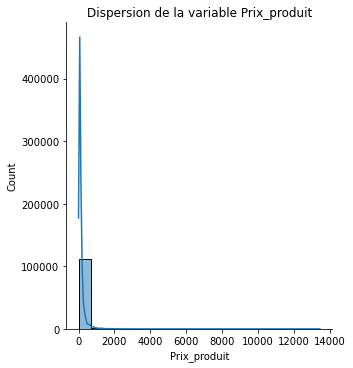

In [1051]:
TraceGraphique(data,'Prix_produit')

In [26]:
i=data['Rapport_liv_prod']==data['Rapport_liv_prod'].max()
data[i]
#la on voit que ce sont des clients beaucoup pour la livraison
#que sur le prix du produit 

,customer_id,customer_unique_id,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,...,payment_sequential,payment_type,payment_installments,payment_value,review_score,Durée_livraison,Montant_achat,Prix_Livraison,Prix_produit,Rapport_liv_prod
31868,5af78bf1a82a2660d1e3fd78c645f58f,f006d7920bd71c252f61ec355eb50dcb,cotia,SP,c5bdd8ef3c0ec420232e668302179113,delivered,2018-04-27 12:37:10,2018-05-05 16:22:05,2.0,8a3254bee785a526d548a81a9bc3c9be,...,1.0,boleto,1.0,54.2,1,8,46.3,44.6,1.7,26.235294


In [1053]:
i=data['Rapport_liv_prod']==data['Rapport_liv_prod'].min()
data[i]
#on voit que le prix du produit ainsi que le prix de la livraison sont 
#égaux

,customer_id,customer_unique_id,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,...,payment_sequential,payment_type,payment_installments,payment_value,review_score,Durée_livraison,Montant_achat,Prix_Livraison,Prix_produit,Rapport_liv_prod
888,6b3dd49a9dcb03a49f8f7e1848d96a21,bdaae7d0dda6bb655f833ebdceaf178e,vitoria,ES,2cba3cbb6058bc3efbf3531e9dcafeb5,delivered,2018-05-12 11:47:38,2018-05-24 19:22:13,1.0,7a10781637204d8d10485c71a6108a2e,...,1.0,credit_card,8.0,199.0,1,12,199.0,0.0,199.0,0.0
994,f4302056f0c58570522590f8181de2c7,67b05b597a66b5c449025000b9430abb,picos,PI,d0bec96aad189992b278688279ba1511,delivered,2018-05-08 21:04:16,2018-05-21 13:06:35,1.0,53b36df67ebb7c41585e8d54d6772e08,...,1.0,credit_card,4.0,99.9,5,12,99.9,0.0,99.9,0.0
1313,979240bcaeb5925525728a666bbeaa33,f845965c44b627242d3fe2ff76fcb908,queimados,RJ,3b10c12d389da3bd306ab31f1867c754,delivered,2018-04-25 20:03:13,2018-05-08 21:46:46,1.0,53b36df67ebb7c41585e8d54d6772e08,...,1.0,credit_card,1.0,99.9,5,13,99.9,0.0,99.9,0.0
1456,c0d6c154f52c6850b032cd4c63602a73,886fa36372fc4428557e3352f37ffc55,conselheiro lafaiete,MG,1d5912d4e665fb2a085a50fc13007c02,delivered,2018-05-08 07:14:16,2018-05-19 12:50:57,1.0,aca2eb7d00ea1a7b8ebd4e68314663af,...,1.0,boleto,1.0,69.9,5,11,69.9,0.0,69.9,0.0
2325,d53e45c9cafa9a93e59f7f5c30ea1a11,da44823c9902dcfdfc8e99d6369797b6,brasilia,DF,c8a118d2edafad1835b83c6a42145427,delivered,2018-05-06 17:40:21,2018-05-14 19:12:23,1.0,aca2eb7d00ea1a7b8ebd4e68314663af,...,1.0,boleto,1.0,69.9,5,8,69.9,0.0,69.9,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111458,4d3280f2dbfc1d6b631448e986a0123d,57ec113f18471789b4c412b02c34368c,fortaleza,CE,0c7207c23f4eb8c3b374c9b6f11d75b7,delivered,2018-04-24 13:24:39,2018-05-16 21:56:26,1.0,53b36df67ebb7c41585e8d54d6772e08,...,1.0,credit_card,3.0,117.9,5,22,117.9,0.0,117.9,0.0
111462,da4486c297ed3a392e9979cd4c0cdea4,7bb289562c6224e0d4d34f513d0aae89,serra,ES,b1ae5dfeac85b9d126aa862b10bd9544,delivered,2018-05-07 11:03:26,2018-05-17 19:58:48,1.0,7a10781637204d8d10485c71a6108a2e,...,1.0,credit_card,8.0,199.0,5,10,199.0,0.0,199.0,0.0
112307,de40e840af17b6227c01ca19031ab896,6a583f4c6790a4c8330beb7612e17f42,rio de janeiro,RJ,a8ae22d68419abf4bbe92b7623b08657,delivered,2018-05-02 15:22:27,2018-05-17 16:47:38,1.0,422879e10f46682990de24d770e7f83d,...,1.0,credit_card,1.0,53.9,5,15,53.9,0.0,53.9,0.0
112467,fdabedbba76cf0308dedcd99afc66626,826303f32007dc49ba0fbf597caf80ec,massape,CE,a2ea081c06c12c25c068089e4985745a,delivered,2018-05-05 09:22:24,2018-05-26 00:08:34,1.0,53b36df67ebb7c41585e8d54d6772e08,...,1.0,credit_card,5.0,110.0,4,20,110.0,0.0,110.0,0.0


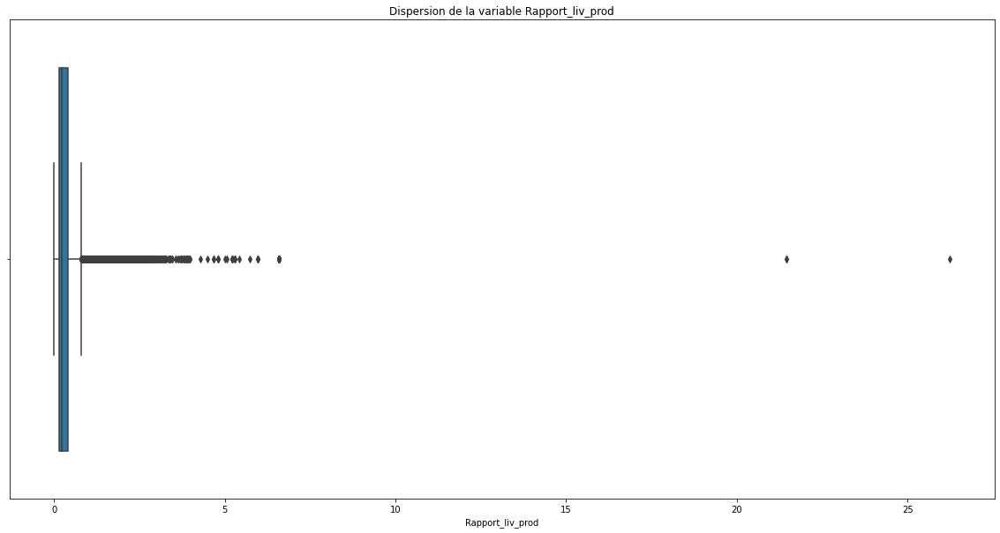

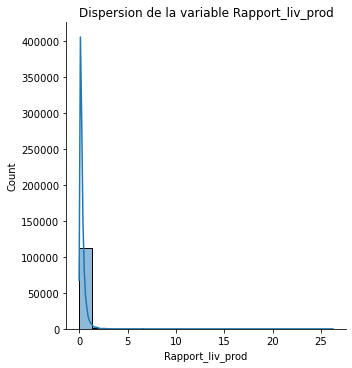

In [1054]:
TraceGraphique(data,'Rapport_liv_prod')

# <font color=grenn > Transformation LOG  </font>

In [22]:
from scipy.special import exp10
exp10(10)

10000000000.0

In [23]:
from sklearn.preprocessing import FunctionTransformer
import math as mt
MTR=FunctionTransformer(func=np.log10,inverse_func=exp10)

In [24]:
data['Montant_achatLOG']=MTR.fit_transform(data['Montant_achat'])

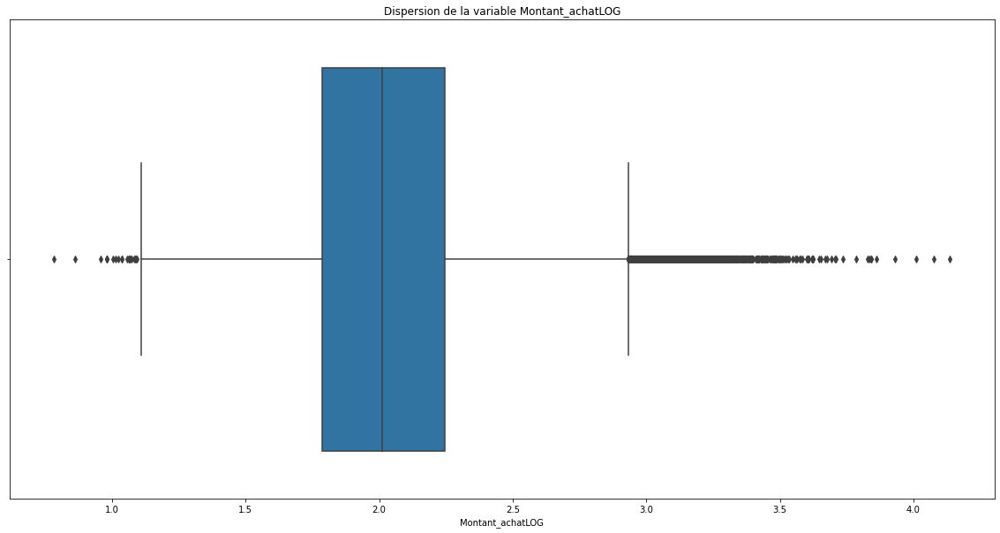

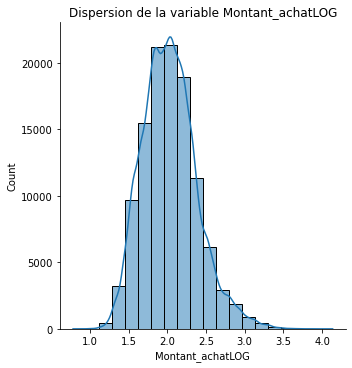

In [25]:
TraceGraphique(data,'Montant_achatLOG')

In [31]:
data['Montant_achatLOG'].describe()

count    114063.000000
mean          2.032767
std           0.353352
min           0.783904
25%           1.786041
50%           2.013006
75%           2.244623
max           4.135580
Name: Montant_achatLOG, dtype: float64

# <font color=grenn > Regroupement des clients   </font>

In [26]:
data['customer_unique_id'].unique().shape

(92075,)

In [27]:
unique_user = pd.DataFrame(data['customer_unique_id'].unique())
#les clients uniques 
unique_user.columns = ['customer_unique_id']

In [28]:
unique_user.shape #de clients uniques 

(92075, 1)

In [22]:
unique_user.head()

,customer_unique_id
0,861eff4711a542e4b93843c6dd7febb0
1,290c77bc529b7ac935b93aa66c333dc3
2,060e732b5b29e8181a18229c7b0b2b5e
3,259dac757896d24d7702b9acbbff3f3c
4,345ecd01c38d18a9036ed96c73b8d066


## Nombre de commandes 

In [29]:
nbrcommandes=data.groupby('customer_unique_id')['customer_id'].count().reset_index()

In [30]:
nbrcommandes.columns=['customer_unique_id','Nombre_de_commandes']

In [31]:
nbrcommandes.head(10)

,customer_unique_id,Nombre_de_commandes
0,0000366f3b9a7992bf8c76cfdf3221e2,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,1
2,0000f46a3911fa3c0805444483337064,1
3,0000f6ccb0745a6a4b88665a16c9f078,1
4,0004aac84e0df4da2b147fca70cf8255,1
5,0004bd2a26a76fe21f786e4fbd80607f,1
6,00050ab1314c0e55a6ca13cf7181fecf,1
7,00053a61a98854899e70ed204dd4bafe,2
8,0005e1862207bf6ccc02e4228effd9a0,1
9,0005ef4cd20d2893f0d9fbd94d3c0d97,1


# <font color=grenn > Calcul RFM   </font>

In [32]:
data['order_purchase_timestamp'].max() #la date la plus recente 
#de notre tableau

Timestamp('2018-08-29 15:00:37')

In [33]:
data['order_purchase_timestamp'].min()
#la date la plus anncienne 

Timestamp('2016-10-03 09:44:50')

## récence

### date max commande

In [34]:
# obtenir la date maximale de commande pour chaque client
max_datecommande = data.groupby('customer_unique_id')[
    'order_purchase_timestamp'].max().reset_index()

In [35]:
max_datecommande

,customer_unique_id,order_purchase_timestamp
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42
...,...,...
92070,fffcf5a5ff07b0908bd4e2dbc735a684,2017-06-08 21:00:36
92071,fffea47cd6d3cc0a88bd621562a9d061,2017-12-10 20:07:56
92072,ffff371b4d645b6ecea244b27531430a,2017-02-07 15:49:16
92073,ffff5962728ec6157033ef9805bacc48,2018-05-02 15:17:41


In [36]:
max_datecommande.columns=['customer_unique_id','date_achat_max']

In [37]:
max_datecommande['date_achat_max'].max()

Timestamp('2018-08-29 15:00:37')

###  Recence à calculer

In [38]:
max_datecommande['Recency'] = (max_datecommande['date_achat_max'].max() - max_datecommande['date_achat_max']).dt.days

In [39]:
max_datecommande.head()#la date la plus recente de commande et recence 

,customer_unique_id,date_achat_max,Recency
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,111
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,114
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03,536
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41,320
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42,287


In [40]:
max_datecommande['Recency'].describe()
#en moyenne un client reste 236 jours avant de commander
#la médiane est de 217
#la moyenne > médiane nous avons la pluspart des données sont supérieurs 
#a la moyenne de 236, la pluspart des clients attendent au moins plus de 236 
#avant de commander

count    92075.000000
mean       236.254684
std        152.575636
min          0.000000
25%        113.000000
50%        217.000000
75%        345.000000
max        694.000000
Name: Recency, dtype: float64

In [41]:
max_datecommande['date_achat_max'].max()

Timestamp('2018-08-29 15:00:37')

In [42]:
#Nous avons 29 clients qui ont commandes la date maximum
#reste 0 jours sans commander 
i=max_datecommande['Recency'] <= max_datecommande['Recency'].min()
sum(i)

29

### Histo recence 

In [284]:
#plot a recency histogram

plot_data = [
    go.Histogram(
        x=max_datecommande['Recency']
    )
]

plot_layout = go.Layout(
        title='Environ 2400 clients sont restés 279 jours sans commander'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

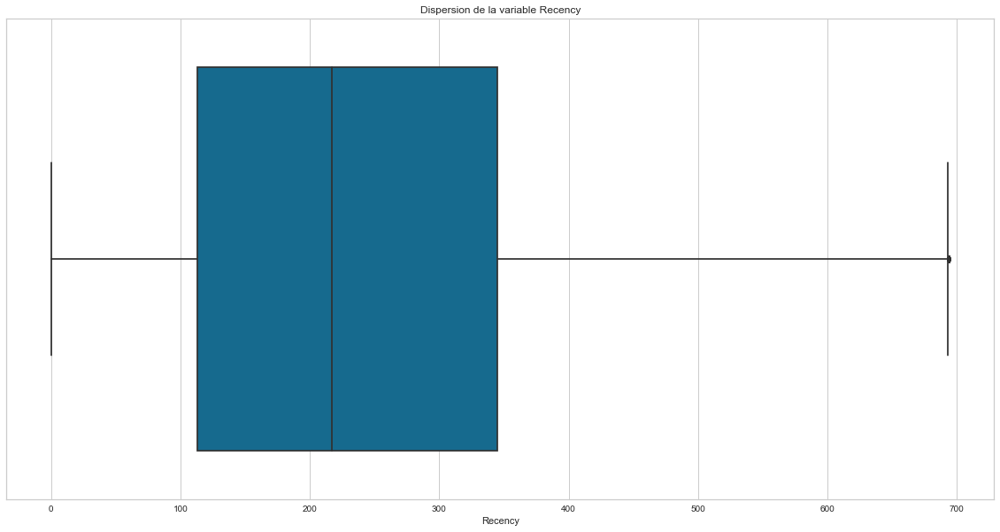

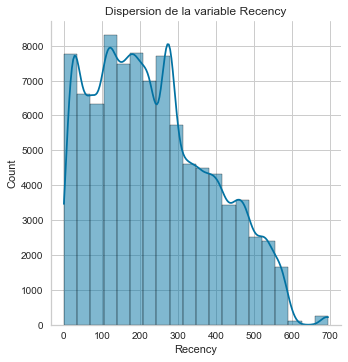

In [291]:
TraceGraphique(max_datecommande,'Recency')

### Concatenation

In [43]:
max_datecommande.shape,nbrcommandes.shape,unique_user.shape
#Nous allons concatener les troix tableaux 
#(la data la plus recente , recence), (le nombre de commandes), 
#(les uniques clients )

((92075, 3), (92075, 2), (92075, 1))

In [44]:
dataEtude=pd.merge(unique_user,max_datecommande,on='customer_unique_id')

In [45]:
dataEtude=pd.merge(dataEtude,nbrcommandes,on='customer_unique_id')

In [46]:
dataEtude.head()

,customer_unique_id,date_achat_max,Recency,Nombre_de_commandes
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16 15:05:35,469,1
1,290c77bc529b7ac935b93aa66c333dc3,2018-01-12 20:48:24,228,1
2,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19 16:07:45,101,1
3,259dac757896d24d7702b9acbbff3f3c,2018-03-13 16:06:38,168,1
4,345ecd01c38d18a9036ed96c73b8d066,2018-07-29 09:51:30,31,1


In [47]:
dataEtude.shape

(92075, 4)

### Verification client 

In [298]:
#Nous avons un client avec un nombre de commandes égal
#à 75 nous allons verifier pour voir si c'est normal 
#on va prendre son identifiant client 
#on mettra dans la base initiale data 
#en prenant la base initiale data 
i=dataEtude['Nombre_de_commandes']==75.000000
dataEtude[i]

,customer_unique_id,date_achat_max,Recency,Nombre_de_commandes
17753,9a736b248f67d166d2fbb006bcb877c3,2017-08-08 20:26:31,385,75


In [299]:
i=data['customer_unique_id']=='9a736b248f67d166d2fbb006bcb877c3'
data[i]
#tout semble correct le client a passe des petites commandes

,customer_id,customer_unique_id,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,...,payment_type,payment_installments,payment_value,review_score,Durée_livraison,Montant_achat,Prix_Livraison,Prix_produit,Rapport_liv_prod,Montant_achatLOG
21450,270c23a11d024a44c896d1894b261a83,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,895ab968e7bb0d5659d16cd74cd1650c,delivered,2017-08-08 20:26:31,2017-08-14 12:46:18,1.0,ebf9bc6cd600eadd681384e3116fda85,...,voucher,1.0,16.70,5,5,36.20,23.21,12.99,1.786759,1.558709
21451,270c23a11d024a44c896d1894b261a83,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,895ab968e7bb0d5659d16cd74cd1650c,delivered,2017-08-08 20:26:31,2017-08-14 12:46:18,1.0,ebf9bc6cd600eadd681384e3116fda85,...,voucher,1.0,2.61,5,5,36.20,23.21,12.99,1.786759,1.558709
21452,270c23a11d024a44c896d1894b261a83,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,895ab968e7bb0d5659d16cd74cd1650c,delivered,2017-08-08 20:26:31,2017-08-14 12:46:18,1.0,ebf9bc6cd600eadd681384e3116fda85,...,voucher,1.0,16.70,5,5,36.20,23.21,12.99,1.786759,1.558709
21453,270c23a11d024a44c896d1894b261a83,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,895ab968e7bb0d5659d16cd74cd1650c,delivered,2017-08-08 20:26:31,2017-08-14 12:46:18,1.0,ebf9bc6cd600eadd681384e3116fda85,...,voucher,1.0,16.70,5,5,36.20,23.21,12.99,1.786759,1.558709
21454,270c23a11d024a44c896d1894b261a83,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,895ab968e7bb0d5659d16cd74cd1650c,delivered,2017-08-08 20:26:31,2017-08-14 12:46:18,1.0,ebf9bc6cd600eadd681384e3116fda85,...,voucher,1.0,0.24,5,5,36.20,23.21,12.99,1.786759,1.558709
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89521,7cfe09e5bc5e9f1fab1a57d8ddd8eaee,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,67d83bd36ec2c7fb557742fb58837659,delivered,2017-07-27 12:50:46,2017-08-01 13:42:28,1.0,4eb99b5f0d7e411f246a5c9c0ae27a5e,...,voucher,1.0,8.00,5,5,72.17,26.97,45.20,0.596681,1.858357
89522,7cfe09e5bc5e9f1fab1a57d8ddd8eaee,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,67d83bd36ec2c7fb557742fb58837659,delivered,2017-07-27 12:50:46,2017-08-01 13:42:28,1.0,4eb99b5f0d7e411f246a5c9c0ae27a5e,...,voucher,1.0,8.00,5,5,72.17,26.97,45.20,0.596681,1.858357
89523,7cfe09e5bc5e9f1fab1a57d8ddd8eaee,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,67d83bd36ec2c7fb557742fb58837659,delivered,2017-07-27 12:50:46,2017-08-01 13:42:28,1.0,4eb99b5f0d7e411f246a5c9c0ae27a5e,...,voucher,1.0,8.00,5,5,72.17,26.97,45.20,0.596681,1.858357
89524,7cfe09e5bc5e9f1fab1a57d8ddd8eaee,9a736b248f67d166d2fbb006bcb877c3,sao paulo,SP,67d83bd36ec2c7fb557742fb58837659,delivered,2017-07-27 12:50:46,2017-08-01 13:42:28,1.0,4eb99b5f0d7e411f246a5c9c0ae27a5e,...,voucher,1.0,2.13,5,5,72.17,26.97,45.20,0.596681,1.858357


In [1090]:
#nous allons vérifier le client qui est reste 694 jours sans commander
i=dataEtude['Recency']==dataEtude['Recency'].max()
dataEtude[i].head()

,customer_unique_id,date_achat_max,Recency,Nombre_de_commandes
4144,30a38716bb2d04f12bb813aa2f926270,2016-10-04 13:30:13,694,1
5420,9f302d00dd3e18ed3745778184b4f0fe,2016-10-04 10:16:04,694,1
7069,f922896769e9517ea3c630f3c8de86d0,2016-10-04 14:23:50,694,1
7380,61db744d2f835035a5625b59350c6b63,2016-10-03 21:13:36,694,1
12066,3f4f614c632af7fc7508462a7cb55ac2,2016-10-04 12:53:17,694,1


## Frequence 

In [48]:
frequence=data.groupby('customer_unique_id')['order_purchase_timestamp'].count().reset_index()

In [49]:
frequence.columns=['customer_unique','frequence_cmd']

In [50]:
frequence['frequence_cmd'].describe()

count    92075.000000
mean         1.238805
std          0.847656
min          1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max         75.000000
Name: frequence_cmd, dtype: float64

In [337]:
dataEtude['Nombre_de_commandes'].describe()
#ceci est la meme chose que la frequence nous allons renommer la colonne 
#par la frequence 

count    92075.000000
mean         1.238805
std          0.847656
min          1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max         75.000000
Name: Nombre_de_commandes, dtype: float64

In [52]:
dataEtude=dataEtude.rename(columns={'Nombre_de_commandes':'Frequence'})

### Histogramme

In [53]:
dataEtude['Frequence'].describe()
#en moyenne un client commande une seule commande
#la mediane est egal à 1
#la moyenne est sensiblement superieur à la mediane 
#la pluspart des données sont superieur a la moyenne 
#a part quelques clients qui sortent du lot en commandant un plus dune commande 

count    92075.000000
mean         1.238805
std          0.847656
min          1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max         75.000000
Name: Frequence, dtype: float64

Text(0.5, 1.0, 'La pluspart des clients ne commandent que une à 2 fois')

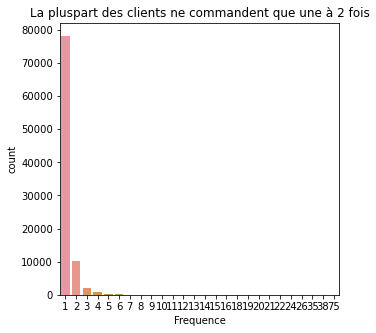

In [64]:
plt.figure(figsize=(5,5))
sns.countplot(x='Frequence',data=dataEtude)
plt.title('La pluspart des clients ne commandent que une à 2 fois')

In [65]:
# plot a frequence histogram

plot_data = [
    go.Histogram(
        x=dataEtude['Frequence']
    )
]

plot_layout = go.Layout(
    title='La pluspart des clients commandent '
)
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

## Montant

In [82]:
data.columns

Index(['customer_id', 'customer_unique_id', 'customer_city', 'customer_state',
       'order_id', 'order_status', 'order_purchase_timestamp',
       'order_delivered_customer_date', 'order_item_id', 'product_id', 'price',
       'freight_value', 'product_category_name_english', 'payment_sequential',
       'payment_type', 'payment_installments', 'payment_value', 'review_score',
       'Durée_livraison', 'Montant_achat', 'Prix_Livraison', 'Prix_produit',
       'Rapport_liv_prod', 'Montant_achatLOG'],
      dtype='object')

### Somme depensee

In [54]:
Montant=data.groupby('customer_unique_id')[['Montant_achat','Prix_Livraison','Prix_produit','Rapport_liv_prod']].sum().reset_index()
Montant.columns=['customer_unique_id','Somme_depensee','Somme_Livraison','Somme_Produit','Rapport_prixlivr_prixproduit']

In [55]:
Montant.columns

Index(['customer_unique_id', 'Somme_depensee', 'Somme_Livraison',
       'Somme_Produit', 'Rapport_prixlivr_prixproduit'],
      dtype='object')

In [205]:
Montant.describe()
#en moyenne un client depense 153
#la mediane est egal a 102, moyenne > mediane la pluspart des données 
#sont superieurs a la moyene 

,Somme_depensee,Somme_Livraison,Somme_Produit,Rapport_prixlivr_prixproduit
count,92075.000000,92075.000000,92075.000000,92075.000000
mean,197.681477,29.266734,168.414743,0.398676
std,431.743486,59.287455,397.609840,0.791336
min,10.070000,0.000000,0.850000,0.000000
25%,64.510000,14.100000,49.000000,0.140698
50%,113.860000,17.860000,92.000000,0.249609
75%,201.080000,27.500000,170.000000,0.456400
max,61488.360000,6282.360000,60480.000000,132.342308


### histogramme 

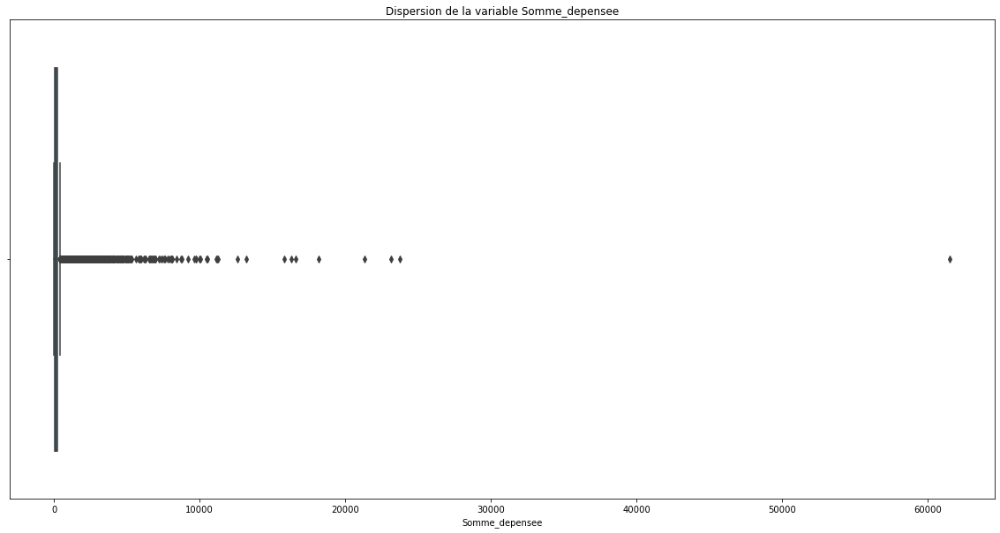

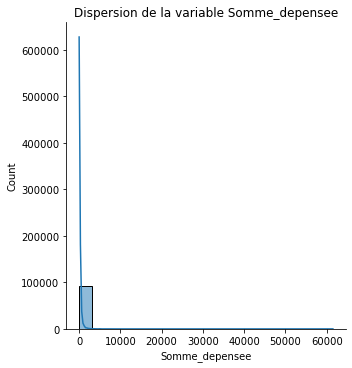

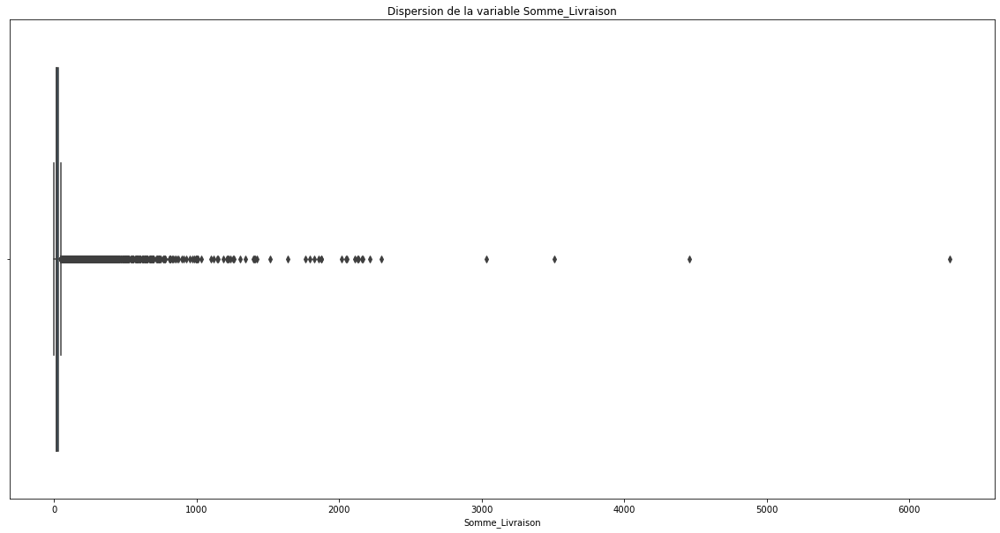

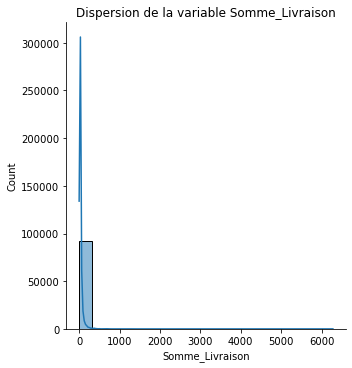

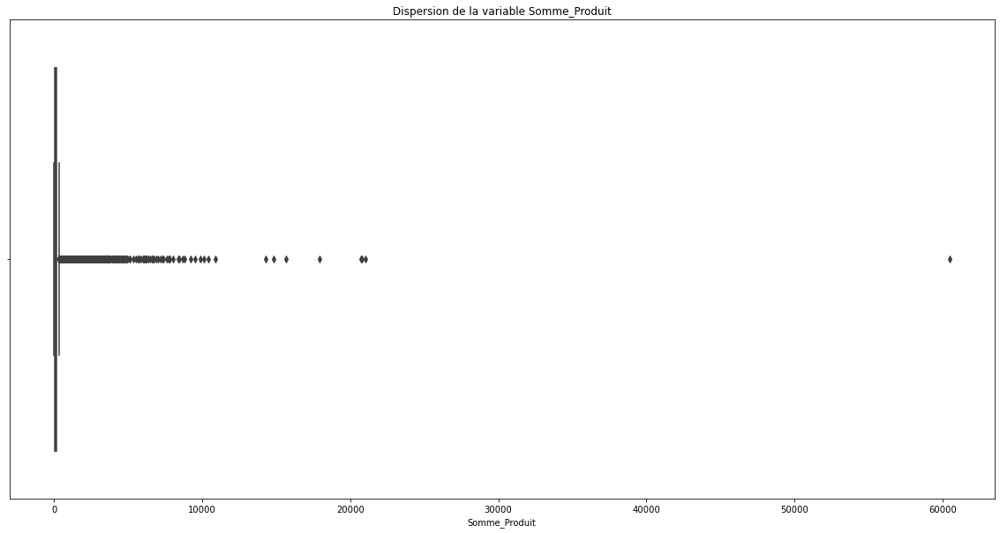

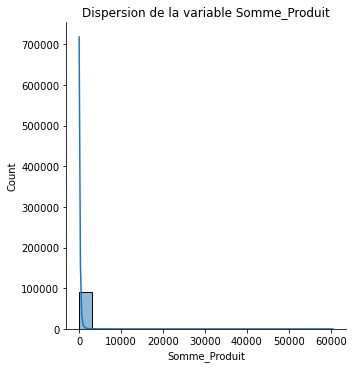

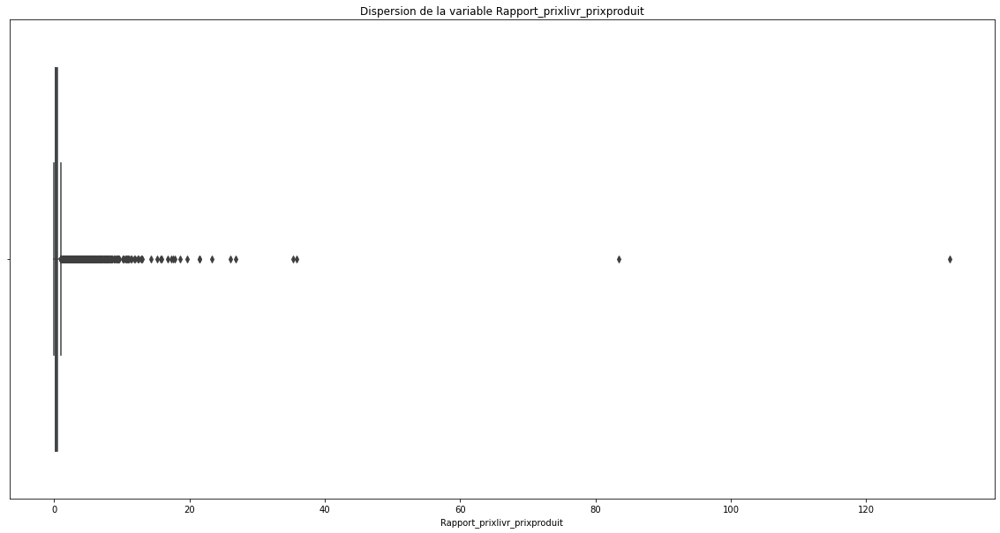

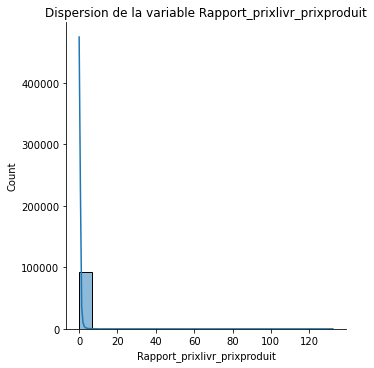

In [206]:
for col in Montant.select_dtypes(['float64']).columns:
    TraceGraphique(Montant,col)

In [207]:
#regardons le client qui depense le plus  dans notre site 
i=Montant['Somme_depensee']==Montant['Somme_depensee'].max()
Montant[i]

,customer_unique_id,Somme_depensee,Somme_Livraison,Somme_Produit,Rapport_prixlivr_prixproduit
3676,0a0a92112bd4c708ca5fde585afaa872,61488.36,1008.36,60480.0,0.133381


In [208]:
#regardonne ce quil a commande 
i=data['customer_unique_id']=='0a0a92112bd4c708ca5fde585afaa872'
data[i]

,customer_id,customer_unique_id,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,...,payment_type,payment_installments,payment_value,review_score,Durée_livraison,Montant_achat,Prix_Livraison,Prix_produit,Rapport_liv_prod,Montant_achatLOG
7127,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29 15:24:52,2017-10-17 18:22:29,1.0,5769ef0a239114ac3a854af00df129e4,...,credit_card,1.0,13664.08,1,18,1708.01,28.01,1680.0,0.016673,3.232490
7128,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29 15:24:52,2017-10-17 18:22:29,2.0,5769ef0a239114ac3a854af00df129e4,...,credit_card,1.0,13664.08,1,18,3416.02,56.02,3360.0,0.016673,3.533520
7129,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29 15:24:52,2017-10-17 18:22:29,3.0,5769ef0a239114ac3a854af00df129e4,...,credit_card,1.0,13664.08,1,18,5124.03,84.03,5040.0,0.016673,3.709612
7130,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29 15:24:52,2017-10-17 18:22:29,4.0,5769ef0a239114ac3a854af00df129e4,...,credit_card,1.0,13664.08,1,18,6832.04,112.04,6720.0,0.016673,3.834550
7131,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29 15:24:52,2017-10-17 18:22:29,5.0,5769ef0a239114ac3a854af00df129e4,...,credit_card,1.0,13664.08,1,18,8540.05,140.05,8400.0,0.016673,3.931460
7132,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29 15:24:52,2017-10-17 18:22:29,6.0,5769ef0a239114ac3a854af00df129e4,...,credit_card,1.0,13664.08,1,18,10248.06,168.06,10080.0,0.016673,4.010642
7133,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29 15:24:52,2017-10-17 18:22:29,7.0,5769ef0a239114ac3a854af00df129e4,...,credit_card,1.0,13664.08,1,18,11956.07,196.07,11760.0,0.016673,4.077588
7134,1617b1357756262bfa56ab541c47bc16,0a0a92112bd4c708ca5fde585afaa872,rio de janeiro,RJ,03caa2c082116e1d31e67e9ae3700499,delivered,2017-09-29 15:24:52,2017-10-17 18:22:29,8.0,5769ef0a239114ac3a854af00df129e4,...,credit_card,1.0,13664.08,1,18,13664.08,224.08,13440.0,0.016673,4.135580


In [56]:
#on va concatener avec notre base detude
dataEtude=pd.merge(dataEtude,Montant,on='customer_unique_id')

In [57]:
dataEtude.columns

Index(['customer_unique_id', 'date_achat_max', 'Recency', 'Frequence',
       'Somme_depensee', 'Somme_Livraison', 'Somme_Produit',
       'Rapport_prixlivr_prixproduit'],
      dtype='object')

In [58]:
dataEtude.shape

(92075, 8)

In [72]:
dataEtude.describe()

,Recency,Frequence,Somme_depensee,Somme_Livraison,Somme_Produit,Rapport_prixlivr_prixproduit
count,92075.000000,92075.000000,92075.000000,92075.000000,92075.000000,92075.000000
mean,236.254684,1.238805,197.681477,29.266734,168.414743,0.398676
std,152.575636,0.847656,431.743486,59.287455,397.609840,0.791336
min,0.000000,1.000000,10.070000,0.000000,0.850000,0.000000
25%,113.000000,1.000000,64.510000,14.100000,49.000000,0.140698
50%,217.000000,1.000000,113.860000,17.860000,92.000000,0.249609
75%,345.000000,1.000000,201.080000,27.500000,170.000000,0.456400
max,694.000000,75.000000,61488.360000,6282.360000,60480.000000,132.342308


###   dépenses de votre client en Log

In [59]:
i=dataEtude['Somme_Livraison'] <= 0
sum(i)
#328 clients qui ont une somme de livraison =0


328

In [60]:
dataEtude=dataEtude.drop(index=dataEtude[i].index)

In [61]:
dataEtude.shape

(91747, 8)

In [62]:
dataEtude['Somme_Livraison'].describe()

count    91747.000000
mean        29.371364
std         59.367462
min          0.060000
25%         14.100000
50%         17.880000
75%         27.550000
max       6282.360000
Name: Somme_Livraison, dtype: float64

In [63]:
dataEtude['Somme_depenseeLOG']=MTR.fit_transform(dataEtude['Somme_depensee'])
dataEtude['Somme_LivraisonLOG']=MTR.fit_transform(dataEtude['Somme_Livraison'])
dataEtude['Somme_ProduitLOG']=MTR.fit_transform(dataEtude['Somme_Produit'])

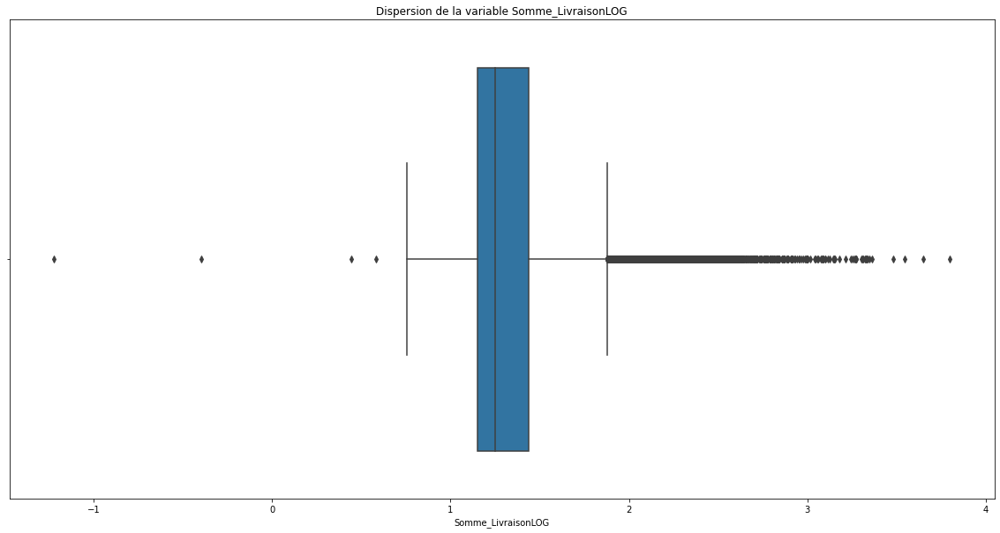

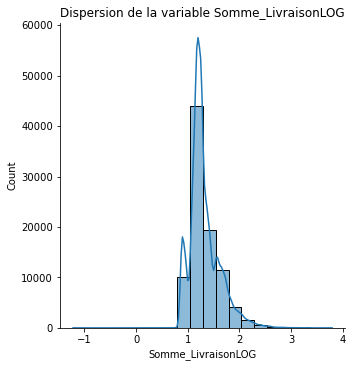

In [216]:
TraceGraphique(dataEtude,'Somme_LivraisonLOG')

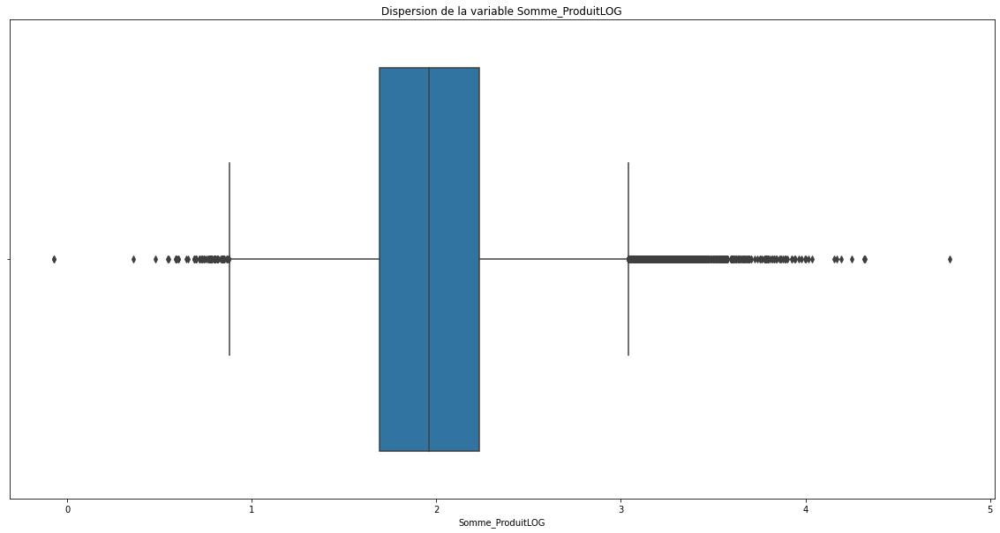

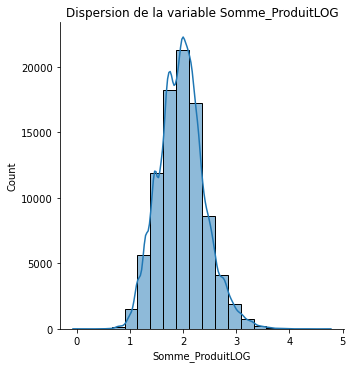

In [79]:
TraceGraphique(dataEtude,'Somme_ProduitLOG')

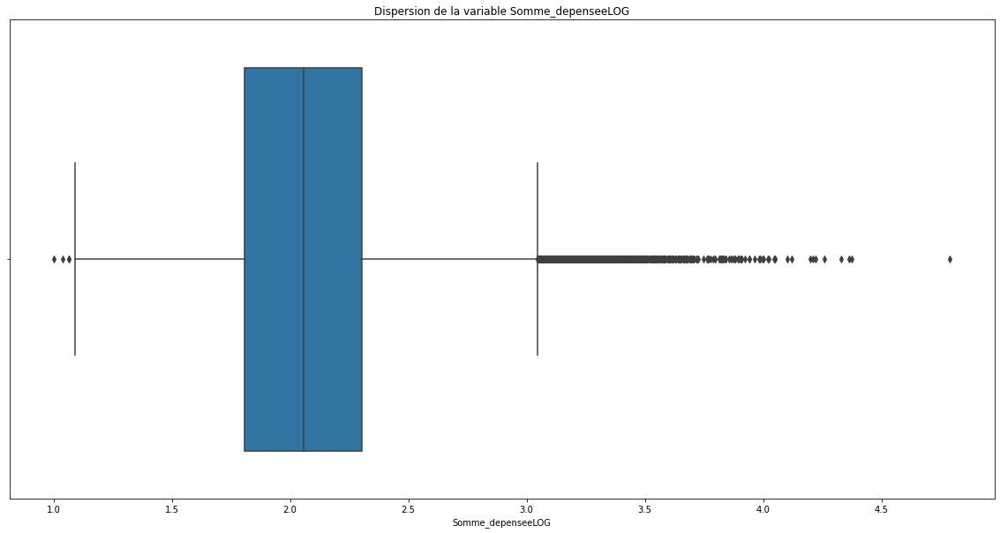

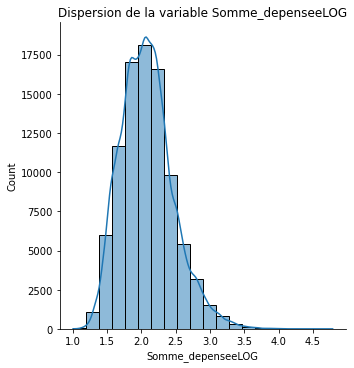

In [1115]:
TraceGraphique(dataEtude,'Somme_depenseeLOG')

In [98]:
dataEtude.shape

(91747, 11)

###  Frequence  recence rapport liv produit

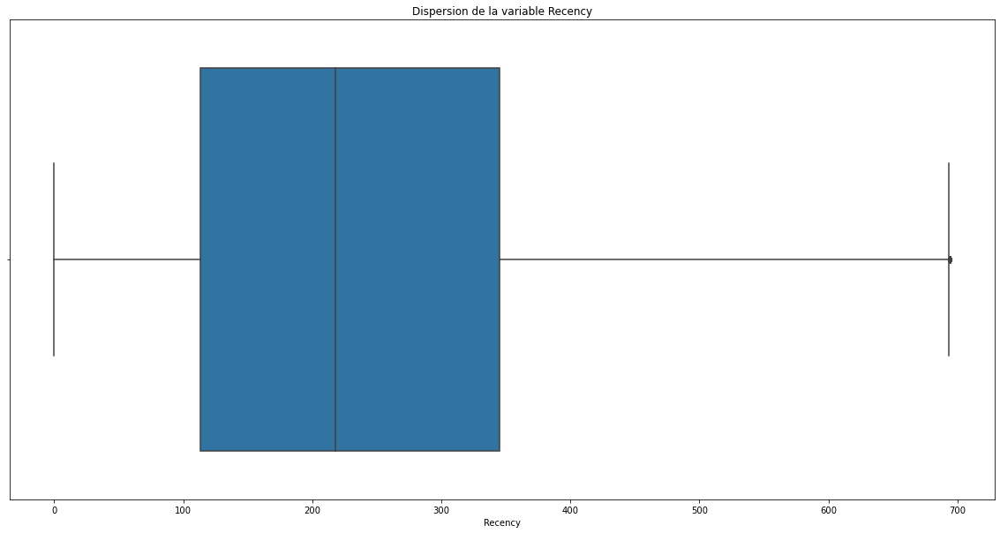

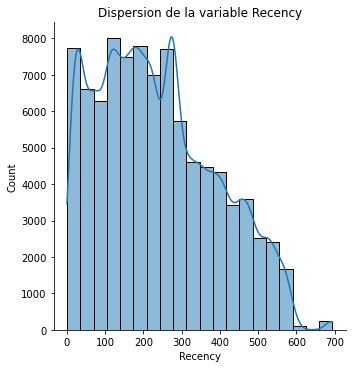

In [99]:
TraceGraphique(dataEtude,'Recency')

In [80]:
dataEtude['Frequence'].value_counts()

1     77911
2     10074
3      1964
4       938
5       325
6       288
7        70
8        45
12       25
9        24
10       24
11       18
14        9
24        7
15        6
20        4
13        4
21        3
18        1
19        1
16        1
22        1
75        1
26        1
35        1
38        1
Name: Frequence, dtype: int64

In [573]:
df2=pd.DataFrame({'Nombre de commande':dataEtude['Frequence'].value_counts().index,'Frequence':dataEtude['Frequence'].value_counts().values})

In [575]:
dataEtude.shape

(91745, 10)

<AxesSubplot:xlabel='Nombre de commande', ylabel='Frequence'>

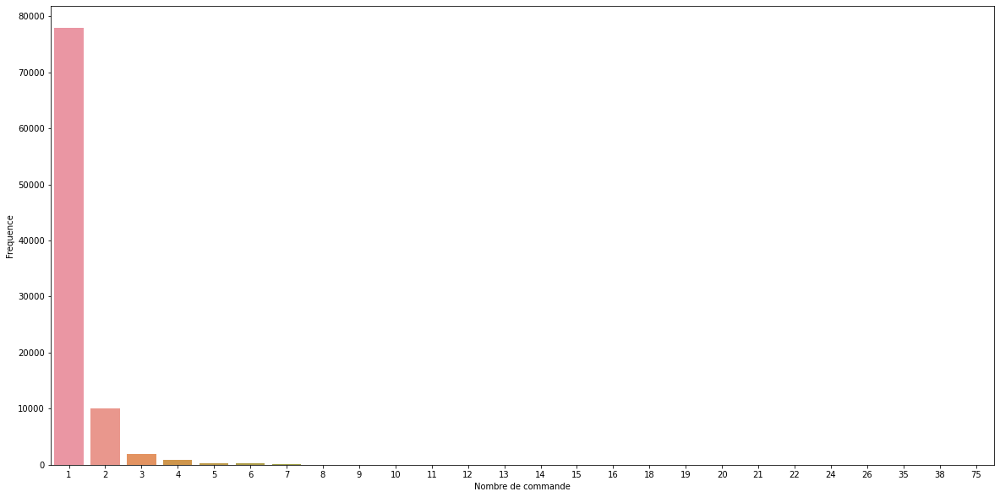

In [576]:
plt.figure(figsize=(20,10))
sns.barplot(x='Nombre de commande',y='Frequence',data=df2.sort_values('Frequence',ascending=False))


In [96]:
dataEtude['Recency'].describe()

count    91747.000000
mean       236.649144
std        152.681956
min          0.000000
25%        113.000000
50%        218.000000
75%        345.000000
max        694.000000
Name: Recency, dtype: float64

In [577]:
#dataEtude['RecencyLOG']=MTR.fit_transform(dataEtude['Recency'])
#dataEtude['FrequenceLOG']=MTR.fit_transform(dataEtude['Frequence'])

In [102]:
dataEtude.columns

Index(['customer_unique_id', 'date_achat_max', 'Recency', 'Frequence',
       'Somme_depensee', 'Somme_Livraison', 'Somme_Produit',
       'Rapport_prixlivr_prixproduit', 'Somme_depenseeLOG',
       'Somme_LivraisonLOG', 'Somme_ProduitLOG'],
      dtype='object')

# <font color=grenn > Score moyen   </font>

In [64]:
Score=data.groupby('customer_unique_id')['review_score'].mean().reset_index()

In [65]:
Score.columns=['customer_unique_id','Score_moyen']

In [49]:
Score['Score_moyen'].describe()
#en moyenne les clients sont assez satisfaits avec une note egal à 4
#la mediane est 5 est superieur a la moyenne 4
#la plus part des données sont inferieures a la moyenne 

count    92075.000000
mean         4.141424
std          1.290610
min          1.000000
25%          4.000000
50%          5.000000
75%          5.000000
max          5.000000
Name: Score_moyen, dtype: float64

## Exploration

In [84]:
df1=pd.DataFrame({'Score_moyen':Score['Score_moyen'].value_counts().index,'Frequence':Score['Score_moyen'].value_counts().values})

Text(0.5, 1.0, 'La majorité de nos clients donnent un score moyen égal à 5')

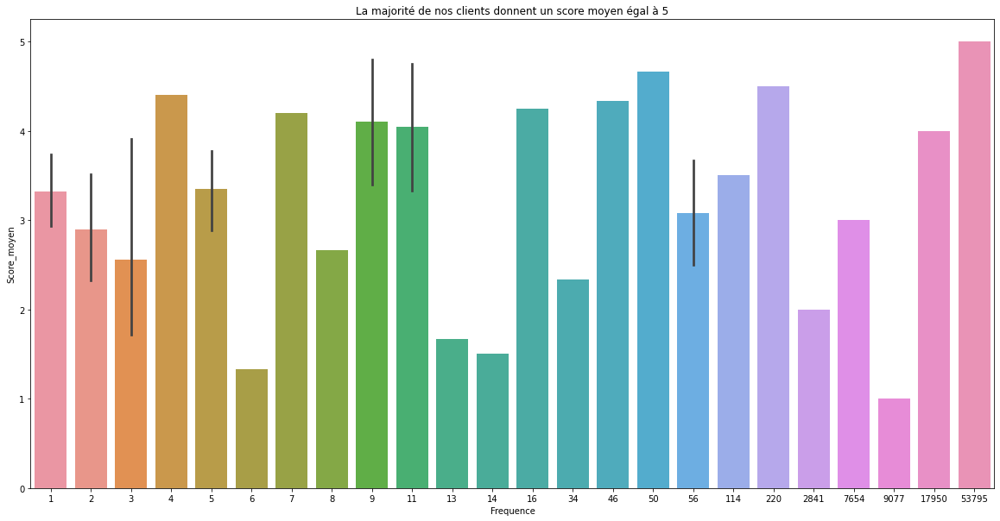

In [90]:
plt.figure(figsize=(20,10))
sns.barplot(y='Score_moyen',x='Frequence',data=df1.sort_values('Frequence',ascending=False))
plt.title('La majorité de nos clients donnent un score moyen égal à 5')

## Regard client

In [1128]:
#regardons les clients ayant donne les plus petites notes 
#ceux qu'ils ont commandes
i=Score['Score_moyen']==Score['Score_moyen'].min()
Score[i]
#on a 9077 clients qui ont donnés une note 1

,customer_unique_id,Score_moyen
7,00053a61a98854899e70ed204dd4bafe,1.0
9,0005ef4cd20d2893f0d9fbd94d3c0d97,1.0
23,0010a452c6d13139e50b57f19f52e04e,1.0
30,0012929d977a8d7280bb277c1e5f589d,1.0
39,0019da6aa6bcb27cc32f1249bd12da05,1.0
...,...,...
92030,ffe0c10afc687bcf34a0451f2b87dd9b,1.0
92035,ffe3e199b9d0b7fb7d2d29a5b9498447,1.0
92049,ffebb6424578e7bb153322da9d65634f,1.0
92051,ffec490ab531184a483efe2eedd68908,1.0


In [1129]:
i=data['customer_unique_id']=='00053a61a98854899e70ed204dd4bafe'
data[i]

,customer_id,customer_unique_id,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,...,payment_type,payment_installments,payment_value,review_score,Durée_livraison,Montant_achat,Prix_Livraison,Prix_produit,Rapport_liv_prod,Montant_achatLOG
72559,a81ebb9b32f102298c0c89635b4b3154,00053a61a98854899e70ed204dd4bafe,curitiba,PR,44e608f2db00c74a1fe329de44416a4e,delivered,2018-02-28 11:15:41,2018-03-16 19:02:51,1.0,62984ea1bba7fcea1f5b57084d3bf885,...,credit_card,3.0,419.18,1,16,209.59,18.59,191.0,0.09733,2.321371
72560,a81ebb9b32f102298c0c89635b4b3154,00053a61a98854899e70ed204dd4bafe,curitiba,PR,44e608f2db00c74a1fe329de44416a4e,delivered,2018-02-28 11:15:41,2018-03-16 19:02:51,2.0,58727e154e8e85d84052cd22b0136c84,...,credit_card,3.0,419.18,1,16,419.18,37.18,382.0,0.09733,2.622401


In [1130]:
i=Score['Score_moyen']==Score['Score_moyen'].max()
Score[i]
#on a presque 53795 clients qui ont mis une note egal à 5

,customer_unique_id,Score_moyen
0,0000366f3b9a7992bf8c76cfdf3221e2,5.0
4,0004aac84e0df4da2b147fca70cf8255,5.0
11,00082cbe03e478190aadbea78542e933,5.0
12,00090324bbad0e9342388303bb71ba0a,5.0
16,000c8bdb58a29e7115cfc257230fb21b,5.0
...,...,...
92069,fffb09418989a0dbff854a28163e47c6,5.0
92070,fffcf5a5ff07b0908bd4e2dbc735a684,5.0
92072,ffff371b4d645b6ecea244b27531430a,5.0
92073,ffff5962728ec6157033ef9805bacc48,5.0


## Concatenation

In [66]:
#concatenation avec notre base detude
dataEtude=pd.merge(dataEtude,Score,on='customer_unique_id')

In [67]:
dataEtude.shape

(91747, 12)

In [170]:
dataEtude.columns

Index(['customer_unique_id', 'date_achat_max', 'Recency', 'Frequence',
       'Somme_depensee', 'Somme_Livraison', 'Somme_Produit',
       'Rapport_prixlivr_prixproduit', 'Somme_depenseeLOG',
       'Somme_LivraisonLOG', 'Somme_ProduitLOG', 'Score_moyen'],
      dtype='object')

# <font color=grenn > Catégories des produits  </font>

## Categorie paye plus cher

In [68]:
cate=data.groupby('customer_unique_id')[['product_category_name_english','Montant_achat']].max().reset_index()
#on va prendre la categorie ou le client a paye le plus sur ces
#paiements

In [69]:
cate.head()

,customer_unique_id,product_category_name_english,Montant_achat
0,0000366f3b9a7992bf8c76cfdf3221e2,HOME,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,BEAUTE,27.19
2,0000f46a3911fa3c0805444483337064,OFFICE,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,ELECTRONICS,43.62
4,0004aac84e0df4da2b147fca70cf8255,ELECTRONICS,196.89


In [70]:
cate.columns

Index(['customer_unique_id', 'product_category_name_english', 'Montant_achat'], dtype='object')

In [71]:
cate=cate.drop(columns=['Montant_achat'])

In [72]:
cate.columns=['customer_unique_id','CATEG_PLUS_ACHETEE']

In [56]:
cate['CATEG_PLUS_ACHETEE'].value_counts()

HOME            16081
ELECTRONICS     14511
BEAUTE          13962
SPORT            8993
FASHION          7543
APPLIANCES       6907
JARDIN_PET       5084
ART              4738
OFFICE           4020
AUTRE            3663
AUTO             3654
CONSTRUCTION     2007
FOOD_DRINK        912
Name: CATEG_PLUS_ACHETEE, dtype: int64

In [103]:
df0=pd.DataFrame({'Modalite':cate['CATEG_PLUS_ACHETEE'].value_counts().index,'Frequence':cate['CATEG_PLUS_ACHETEE'].value_counts().values})

Text(0.5, 1.0, 'La catégorie la plus achetée avec le montant le plus cher est HOME')

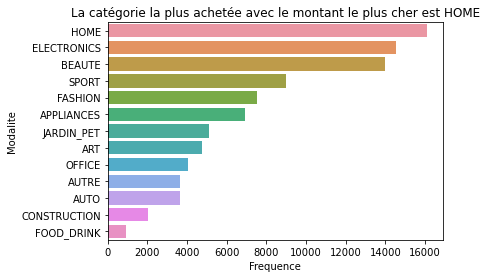

In [106]:
plt.figure()
sns.barplot(y='Modalite',x='Frequence',data=df0.sort_values('Frequence',ascending=False));
plt.title('La catégorie la plus achetée avec le montant le plus cher est HOME')

In [361]:
cate.columns

Index(['customer_unique_id', 'CATEG_PLUS_ACHETEE'], dtype='object')

In [57]:
#on va concatener avec la table cate qui est celle avec la categorie 
#la plus achetée par les clients 
dataEtude=pd.merge(dataEtude,cate,on='customer_unique_id')

In [58]:
dataEtude.shape,cate.shape

((91747, 13), (92075, 2))

# <font color=grenn > Type de paiement utilisé </font>

## Paiement utilise pour le montant plus cher

In [112]:
data['payment_type'].value_counts()

credit_card    84170
boleto         22196
voucher         6067
debit_card      1630
Name: payment_type, dtype: int64

In [73]:
mode_paiement=data.groupby('customer_unique_id')[['payment_type','Montant_achat']].max().reset_index()

In [74]:
mode_paiement.columns

Index(['customer_unique_id', 'payment_type', 'Montant_achat'], dtype='object')

In [75]:
mode_paiement.shape

(92075, 3)

In [369]:
mode_paiement.head()

,customer_unique_id,payment_type,Montant_achat
0,0000366f3b9a7992bf8c76cfdf3221e2,credit_card,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,credit_card,27.19
2,0000f46a3911fa3c0805444483337064,credit_card,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,credit_card,43.62
4,0004aac84e0df4da2b147fca70cf8255,credit_card,196.89


In [76]:
mode_paiement=mode_paiement.drop(columns=['Montant_achat'])

In [77]:
mode_paiement.columns=['customer_unique_id','paiement_plus_utilise']

In [78]:
mode_paiement.head()

,customer_unique_id,paiement_plus_utilise
0,0000366f3b9a7992bf8c76cfdf3221e2,credit_card
1,0000b849f77a49e4a4ce2b2a4ca5be3f,credit_card
2,0000f46a3911fa3c0805444483337064,credit_card
3,0000f6ccb0745a6a4b88665a16c9f078,credit_card
4,0004aac84e0df4da2b147fca70cf8255,credit_card


In [81]:
dataEtude=pd.merge(dataEtude,mode_paiement,on='customer_unique_id')

In [82]:
dataEtude.shape

(91747, 14)

In [377]:
dataEtude['paiement_plus_utilise'].value_counts()

credit_card    68611
boleto         18174
voucher         3530
debit_card      1432
Name: paiement_plus_utilise, dtype: int64

Text(0.5, 1.0, '68611 commandes ont été payés en CB et 18174 en boleto pour le produit le plus cher')

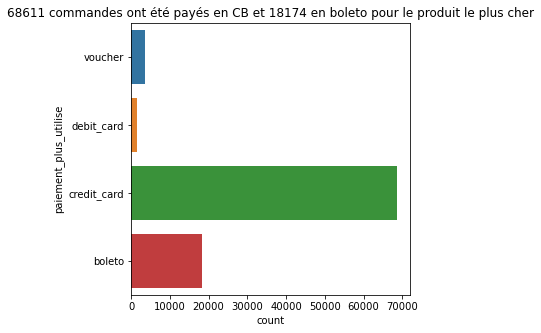

In [125]:
plt.figure(figsize=(5,5))
sns.countplot(y='paiement_plus_utilise',data=dataEtude.sort_values('paiement_plus_utilise',ascending=False))
plt.title('68611 commandes ont été payés en CB et 18174 en boleto pour le produit le plus cher')

# <font color=grenn > Durée livraison moyen  </font>

In [83]:
Liv=data.groupby('customer_unique_id')['Durée_livraison'].mean().reset_index()
Liv.columns=['customer_unique_id','Durée_moyen_livraison']

In [84]:
Liv.describe()

,Durée_moyen_livraison
count,92075.000000
mean,10.565120
std,164.741939
min,-17714.000000
25%,6.000000
50%,10.000000
75%,15.000000
max,209.000000


## Suppression individus <0

In [85]:
j=Liv['Durée_moyen_livraison'] < 0
Liv[j]

#8 individus 

,customer_unique_id,Durée_moyen_livraison
6986,13467e882eb3a701826435ee4424f2bd,-17499.0
8480,175378436e2978be55b8f4316bce4811,-17710.0
10089,1bd06a0c0df8b23dacfd3725d2dc0bb9,-17714.0
17012,2f17c5b324ad603491521b279a9ff4de,-17703.0
21573,3bc508d482a402715be4d5cf4020cc81,-17714.0
73811,cce5e8188bf42ffb3bb5b18ff58f5965,-17691.0
77636,d77cf4be2654aa70ef150f8bfec076a6,-17312.0
84988,ebf7e0d43a78c81991a4c59c145c75db,-17714.0


In [86]:
data['order_delivered_customer_date'].min()
#ceci est un probléme on ne peut pas avoir 
#des commandes livres en 1970 et ils sont commandes en 2018
#on va les supprimer 

Timestamp('1970-01-01 00:00:00')

In [87]:
i=(data['customer_unique_id']=='3bc508d482a402715be4d5cf4020cc81') | (data['customer_unique_id']=='ebf7e0d43a78c81991a4c59c145c75db')| (data['customer_unique_id']=='1bd06a0c0df8b23dacfd3725d2dc0bb9')
data[i]

,customer_id,customer_unique_id,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_delivered_customer_date,order_item_id,product_id,...,payment_type,payment_installments,payment_value,review_score,Durée_livraison,Montant_achat,Prix_Livraison,Prix_produit,Rapport_liv_prod,Montant_achatLOG
15328,29f0540231702fda0cfdee0a310f11aa,1bd06a0c0df8b23dacfd3725d2dc0bb9,pindamonhangaba,SP,2ebdfc4f15f23b91474edf87475f108e,delivered,2018-07-01 17:05:11,1970-01-01,1.0,e7d5464b94c9a5963f7c686fc80145ad,...,credit_card,3.0,158.07,5,-17714,158.07,19.07,139.00,0.137194,2.198849
100095,cfda40ca8dd0a5d486a9635b611b398a,3bc508d482a402715be4d5cf4020cc81,sumare,SP,e69f75a717d64fc5ecdfae42b2e8e086,delivered,2018-07-01 22:05:55,1970-01-01,1.0,e7d5464b94c9a5963f7c686fc80145ad,...,credit_card,1.0,158.07,5,-17714,158.07,19.07,139.00,0.137194,2.198849
102387,4f1d63d35fb7c8999853b2699f5c7649,ebf7e0d43a78c81991a4c59c145c75db,sao carlos,SP,0d3268bad9b086af767785e3f0fc0133,delivered,2018-07-01 21:14:02,1970-01-01,1.0,ec165cd31c50585786ffda6feff5d0a6,...,credit_card,4.0,204.62,5,-17714,204.62,15.63,188.99,0.082703,2.310948


In [88]:
#Nous allons supprimer ces individus
Liv=Liv.drop(index=Liv[j].index)

In [89]:
Liv.describe()

,Durée_moyen_livraison
count,92067.000000
mean,12.098150
std,9.547579
min,0.000000
25%,6.000000
50%,10.000000
75%,15.000000
max,209.000000


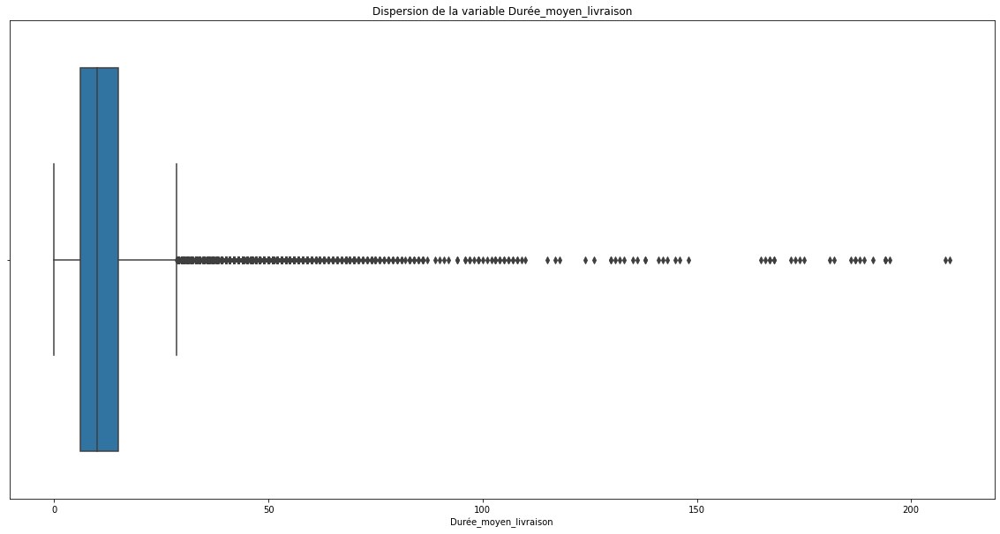

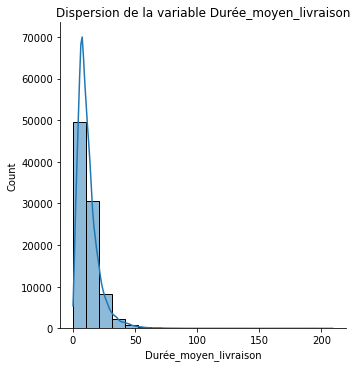

In [134]:
TraceGraphique(Liv,'Durée_moyen_livraison')

In [250]:
Liv.shape,dataEtude.shape

((92067, 2), (91747, 15))

## Concatenation

In [90]:
dataEtude=pd.merge(dataEtude,Liv,on='customer_unique_id')

In [91]:
dataEtude.shape

(91739, 15)

# <font color=grenn > Etat résidentiel  </font>

In [92]:
etat=data.groupby(['customer_unique_id'])[['customer_state']].apply(lambda x: x.value_counts().index[0]).reset_index()

In [93]:
etat.head()

,customer_unique_id,0
0,0000366f3b9a7992bf8c76cfdf3221e2,"(SP,)"
1,0000b849f77a49e4a4ce2b2a4ca5be3f,"(SP,)"
2,0000f46a3911fa3c0805444483337064,"(SC,)"
3,0000f6ccb0745a6a4b88665a16c9f078,"(PA,)"
4,0004aac84e0df4da2b147fca70cf8255,"(SP,)"


In [94]:
etat=etat.rename(columns={0:'Etat_habitation'})

In [95]:
etat['Etat_habitation']=etat['Etat_habitation'].astype('object')

In [96]:
r=[]
for i in range(len(etat['Etat_habitation'])):
    r.append(etat['Etat_habitation'][i][0])
etat['Etat_habitation']=r

In [97]:
etat.shape

(92075, 2)

In [98]:
etat.head()

,customer_unique_id,Etat_habitation
0,0000366f3b9a7992bf8c76cfdf3221e2,SP
1,0000b849f77a49e4a4ce2b2a4ca5be3f,SP
2,0000f46a3911fa3c0805444483337064,SC
3,0000f6ccb0745a6a4b88665a16c9f078,PA
4,0004aac84e0df4da2b147fca70cf8255,SP


## Concatenation

In [99]:
dataEtude=pd.merge(dataEtude,etat,on='customer_unique_id')

In [100]:
dataEtude.shape

(91739, 16)

In [197]:
df=pd.DataFrame({'Modalite':dataEtude['Etat_habitation'].value_counts().index,'effectif': dataEtude['Etat_habitation'].value_counts().values})

Text(0.5, 1.0, '42% de nos clients se trouvent à Sao Paulo')

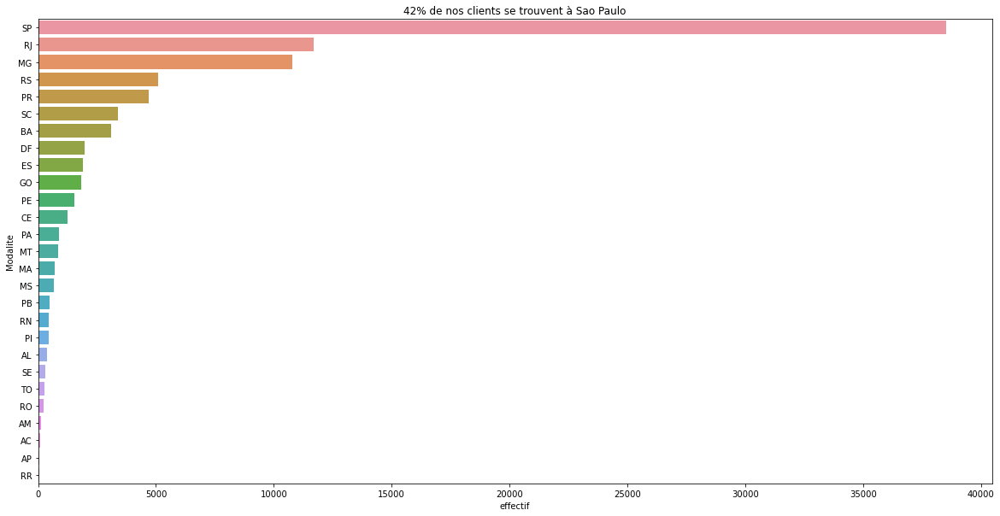

In [263]:
plt.figure(figsize=(20,10))
sns.barplot(y='Modalite',x='effectif',data=df.sort_values('effectif',ascending=False))
plt.title('42% de nos clients se trouvent à Sao Paulo')

#  <font color=grenn > Nombre de paiement </font>

In [101]:
sequence=data.groupby('customer_unique_id')['payment_installments'].mean().reset_index()

In [102]:
sequence.head()

,customer_unique_id,payment_installments
0,0000366f3b9a7992bf8c76cfdf3221e2,8.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,1.0
2,0000f46a3911fa3c0805444483337064,8.0
3,0000f6ccb0745a6a4b88665a16c9f078,4.0
4,0004aac84e0df4da2b147fca70cf8255,6.0


In [103]:
sequence.columns=['customer_unique_id','Sequence_paiement']

In [104]:
dataEtude=pd.merge(dataEtude,sequence,on='customer_unique_id')

In [105]:
Missing(dataEtude)

customer_unique_id              0.0
date_achat_max                  0.0
Recency                         0.0
Frequence                       0.0
Somme_depensee                  0.0
Somme_Livraison                 0.0
Somme_Produit                   0.0
Rapport_prixlivr_prixproduit    0.0
Somme_depenseeLOG               0.0
Somme_LivraisonLOG              0.0
Somme_ProduitLOG                0.0
Score_moyen                     0.0
paiement_plus_utilise_x         0.0
paiement_plus_utilise_y         0.0
Durée_moyen_livraison           0.0
Etat_habitation                 0.0
Sequence_paiement               0.0
dtype: float64

# <font color=grenn > Analyse exploratoire   </font>

In [403]:
dataEtude['CATEG_PLUS_ACHETEE'].head()

0        OFFICE
1    APPLIANCES
2        OFFICE
3        OFFICE
4          HOME
Name: CATEG_PLUS_ACHETEE, dtype: object

<AxesSubplot:>

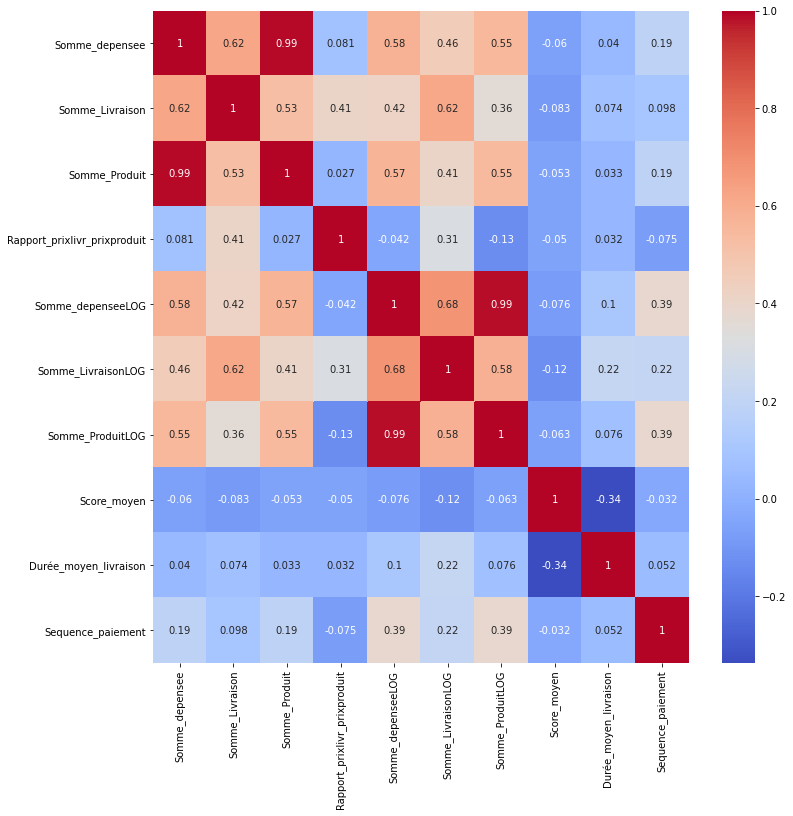

In [270]:
d=dataEtude.drop(columns=['Recency','Frequence'])
cor=d.corr()
fig,ax=plt.subplots(figsize=(12,12))
sns.heatmap(cor,annot=True,ax=ax,cmap='coolwarm')
#la corrrélation entre le prix d'un article et le paiement est de 0.73

In [405]:
t=pd.pivot_table(dataEtude[['paiement_plus_utilise','CATEG_PLUS_ACHETEE']],index='CATEG_PLUS_ACHETEE',columns='paiement_plus_utilise',aggfunc=len,dropna=False,margins=True,margins_name='Total')


In [406]:
from scipy.stats import chi2_contingency
st_chi2, st_p, st_dof, st_exp = chi2_contingency(t)

In [407]:
st_p
# H0 independance 
#H1 dependance 
#pvalue < 0.05 on accepte H1

1.8427742223507667e-51

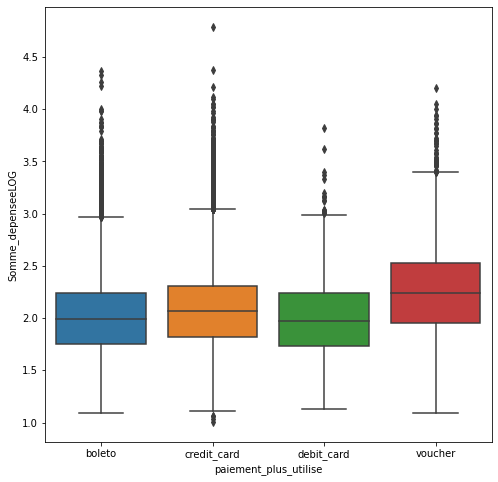

In [280]:

Trace_Box(dataEtude,'Somme_depenseeLOG','paiement_plus_utilise' )

In [282]:
from pingouin import kruskal
kruskal(data=dataEtude,dv='Somme_depenseeLOG',between='paiement_plus_utilise')

,Source,ddof1,H,p-unc
Kruskal,paiement_plus_utilise,3,1218.396828,7.476200e-264


# <font color=red > ACP réduction linéaire  </font>

In [106]:
dataEtude=dataEtude.reset_index(drop=True)
dataEtude.shape

(91739, 17)

In [107]:
dataEtude.head()

,customer_unique_id,date_achat_max,Recency,Frequence,Somme_depensee,Somme_Livraison,Somme_Produit,Rapport_prixlivr_prixproduit,Somme_depenseeLOG,Somme_LivraisonLOG,Somme_ProduitLOG,Score_moyen,paiement_plus_utilise_x,paiement_plus_utilise_y,Durée_moyen_livraison,Etat_habitation,Sequence_paiement
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16 15:05:35,469,1,146.87,21.88,124.99,0.175054,2.166933,1.340047,2.096875,4.0,credit_card,credit_card,8.0,SP,2.0
1,290c77bc529b7ac935b93aa66c333dc3,2018-01-12 20:48:24,228,1,335.48,46.48,289.00,0.160830,2.525667,1.667266,2.460898,5.0,credit_card,credit_card,16.0,SP,8.0
2,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19 16:07:45,101,1,157.73,17.79,139.94,0.127126,2.197914,1.250176,2.145942,5.0,credit_card,credit_card,26.0,SP,7.0
3,259dac757896d24d7702b9acbbff3f3c,2018-03-13 16:06:38,168,1,173.30,23.36,149.94,0.155796,2.238799,1.368473,2.175918,5.0,credit_card,credit_card,14.0,SP,1.0
4,345ecd01c38d18a9036ed96c73b8d066,2018-07-29 09:51:30,31,1,252.25,22.25,230.00,0.096739,2.401831,1.347330,2.361728,5.0,credit_card,credit_card,11.0,SP,8.0


In [108]:
dataEtude.columns

Index(['customer_unique_id', 'date_achat_max', 'Recency', 'Frequence',
       'Somme_depensee', 'Somme_Livraison', 'Somme_Produit',
       'Rapport_prixlivr_prixproduit', 'Somme_depenseeLOG',
       'Somme_LivraisonLOG', 'Somme_ProduitLOG', 'Score_moyen',
       'paiement_plus_utilise_x', 'paiement_plus_utilise_y',
       'Durée_moyen_livraison', 'Etat_habitation', 'Sequence_paiement'],
      dtype='object')

## Choix features 

In [109]:
features=['customer_unique_id','Recency', 'Frequence','Somme_depenseeLOG', 'Somme_LivraisonLOG','Somme_ProduitLOG']

In [110]:
index=dataEtude.columns.isin(features)

In [111]:
dataModel=dataEtude[dataEtude.columns[index]]

In [112]:
dataModel.shape

(91739, 6)

In [113]:
dataModel.columns

Index(['customer_unique_id', 'Recency', 'Frequence', 'Somme_depenseeLOG',
       'Somme_LivraisonLOG', 'Somme_ProduitLOG'],
      dtype='object')

In [114]:
dataModel.describe()

,Recency,Frequence,Somme_depenseeLOG,Somme_LivraisonLOG,Somme_ProduitLOG
count,91739.000000,91739.000000,91739.000000,91739.000000,91739.000000
mean,236.657561,1.239168,2.082503,1.320752,1.974204
std,152.680433,0.848708,0.384901,0.294541,0.432912
min,0.000000,1.000000,1.003029,-1.221849,-0.070581
25%,113.000000,1.000000,1.809021,1.149219,1.690196
50%,218.000000,1.000000,2.057400,1.252368,1.961658
75%,345.000000,1.000000,2.304232,1.440122,2.230449
max,694.000000,75.000000,4.788793,3.798123,4.781612


<AxesSubplot:>

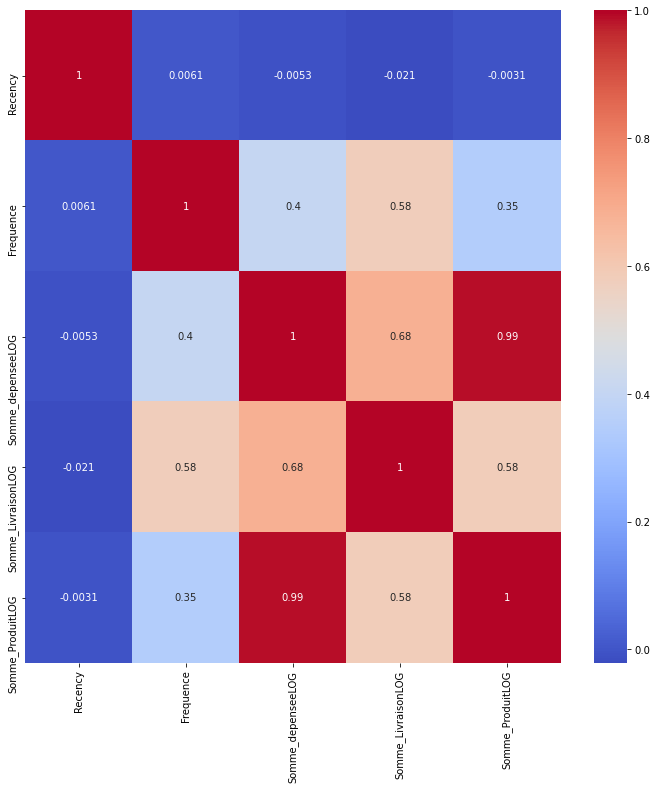

In [164]:
cor=dataModel.corr()
fig,ax=plt.subplots(figsize=(12,12))
sns.heatmap(cor,annot=True,ax=ax,cmap='coolwarm')
#la corrrélation entre le prix d'un article et le paiement est de 0.73

## choix features

In [115]:
X = dataModel.drop(columns='customer_unique_id').values
# transformation de nos variables en array

In [116]:
features = dataModel.drop(columns='customer_unique_id').columns

In [117]:
features

Index(['Recency', 'Frequence', 'Somme_depenseeLOG', 'Somme_LivraisonLOG',
       'Somme_ProduitLOG'],
      dtype='object')

## Standardisation

In [118]:
#centrer et reduire
#on fait x-moyenne/ecart type
#on transforme nos variables avec une moyenne =0 et ecart =1

In [119]:
from sklearn.preprocessing import StandardScaler
X_scaled=StandardScaler().fit_transform(X)

In [120]:
X_scaled.mean(),X_scaled.var()

(-3.043578777229847e-16, 1.0)

In [421]:
#X_scaled[:,0]#recency#X_scaled[:,1]#Frequence
#X_scaled[:,2]#somme depenseeLOg
#X_scaled[:,3]#somme livraison log
#X_scaled[:,4]#somme produit
#X_scaled[:,5]#rapport
#X_scaled[:,6]#sequence

## ACP

In [214]:
from sklearn import decomposition

In [215]:
n_comp=4#nombre de composantes maximum a calculer pour l'acp
#F1,2,3
#Calcul des composantes principales avec le nombre de composantes 
#egal a n_comp maximal
pca=decomposition.PCA(n_components=n_comp)
pca.fit(X_scaled)
#nous luis donnons les données centrés et réduites  
#nous lui donnons les données quantitatives en vue quil calcul les composantes 

PCA(n_components=4)

## Choix nb composante

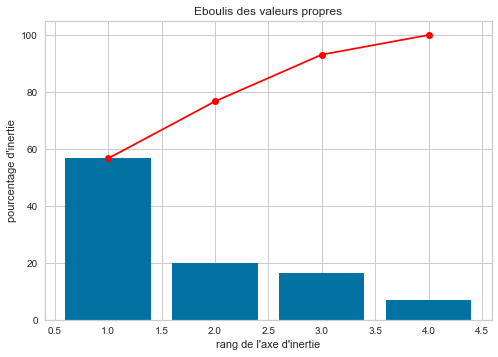

In [424]:
#graphique eboulis des valeurs propres
#pour la representation de nos individus 
display_scree_plot(pca)

## Composante 

In [174]:
features

Index(['Recency', 'Frequence', 'Somme_depenseeLOG', 'Somme_LivraisonLOG',
       'Somme_ProduitLOG'],
      dtype='object')

In [305]:
#affichage du cercle de correlations
pcs=pca.components_ #calcul des différents composantes

In [306]:
#pcs[0]#F1

In [307]:
pca.explained_variance_ratio_ 
#proportion de variance expliquée pour chaque axe factoriel 

array([0.56610366, 0.20009271, 0.16404017, 0.06900973])

In [308]:
pca.explained_variance_
#valeurs propres variance expliquee

array([2.83054917, 1.00047448, 0.8202098 , 0.34505242])

In [425]:
pca.explained_variance_ratio_.cumsum()
#proportion de variance cumulée
#avec 2 composantes nous avons 76 % de variance expliquée 

array([0.56610366, 0.76619638, 0.93023655, 0.99924628])

##  Contribution

In [426]:
n=dataModel.drop(columns='customer_unique_id').shape[0]
p=dataModel.drop(columns='customer_unique_id').shape[1]
eigval=(n-1)/n*pca.explained_variance_#valeurs propres
#racine carre valeur propre
sqrt_eigval=np.sqrt(eigval)
corvar=np.zeros((p,p))
for k in range(4):
  corvar[:,k]=pca.components_[k,:]*sqrt_eigval[k]
print(corvar) #affichage matrice de correlation
#les variables sont en ligne et les facteurs en colonnes 
#matice des corrélation

[[-0.0117336   0.99972433 -0.01178629 -0.01657292  0.        ]
 [ 0.6453272   0.02678878  0.70606443  0.29035868  0.        ]
 [ 0.94302283  0.00314063 -0.32181924  0.07125469  0.        ]
 [ 0.8435287  -0.0160202   0.24457038 -0.47784564  0.        ]
 [ 0.90172098  0.00553902 -0.39768413  0.16447537  0.        ]]


In [427]:
df=pd.DataFrame({'id':dataModel.drop(columns='customer_unique_id').columns,'COR_1':corvar[:,0],'COR_2':corvar[:,1]})
df #matrice de corrélation pour les deux premiers plans 

,id,COR_1,COR_2
0,Recency,-0.011734,0.999724
1,Frequence,0.645327,0.026789
2,Somme_depenseeLOG,0.943023,0.003141
3,Somme_LivraisonLOG,0.843529,-0.016020
4,Somme_ProduitLOG,0.901721,0.005539


## cercle

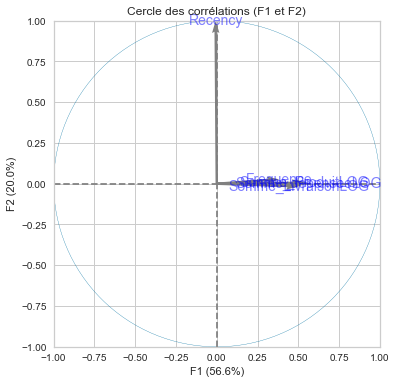

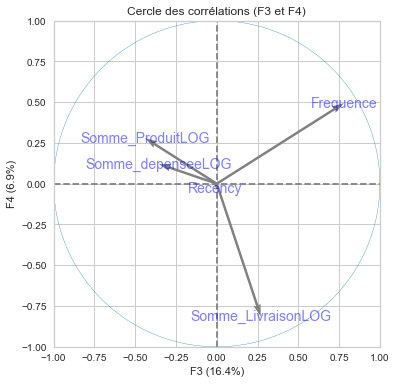

In [312]:
display_circles(pcs,n_comp,pca,[(0,1),(2,3)],labels=np.array(features))

Text(0, 0.5, 'PC2 (20.3%)')

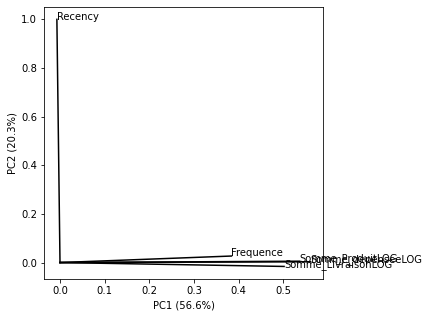

In [183]:
#enumerate permet de prendre les index et valeur
#zip permet d'afficher les elements de deux listes 
plt.figure(figsize=(5,5))
for i,(x,y) in enumerate(zip(pcs[0,:],pcs[1,:])):
    plt.plot([0,x],[0,y],color='k')
    plt.text(x,y,dataModel.drop(columns='customer_unique_id').columns[i])
#plt.axhline(0,c='black',ls='--')
#plt.axvline(0,c='black',ls='--')
plt.xlabel('PC1 (56.6%)')
plt.ylabel('PC2 (20.3%)')

## Projection

In [216]:
X_projected=pca.transform(X_scaled)

In [314]:
X_projected[:,0]#F1 les nouvelles variables 

array([ 0.18896802,  1.7300816 ,  0.1586586 , ..., -1.16276263,
        2.11851615, -2.95041743])

In [186]:
X_projected[:,1]#F2

array([ 1.5146541 , -0.07322459, -0.88863187, ..., -0.63289217,
        0.41009671,  0.10613477])

In [187]:
dataEtude.columns

Index(['customer_unique_id', 'date_achat_max', 'Recency', 'Frequence',
       'Somme_depensee', 'Somme_Livraison', 'Somme_Produit',
       'Rapport_prixlivr_prixproduit', 'Somme_depenseeLOG',
       'Somme_LivraisonLOG', 'Somme_ProduitLOG', 'Score_moyen',
       'paiement_plus_utilise', 'Durée_moyen_livraison', 'Etat_habitation',
       'Sequence_paiement', 'CATEG_PLUS_ACHETEE'],
      dtype='object')

In [429]:
# Transformation en DataFrame pandas 
#pour le  premier plan factoriel 
#choix grace a la methode du coude 
pca_df = pd.DataFrame({
    "Dim1" : X_projected[:,0], 
    "Dim2" : X_projected[:,1], 
    "Paiement" : dataEtude['paiement_plus_utilise'],
    "Categorie" : dataEtude['CATEG_PLUS_ACHETEE'],
    "client": dataEtude['customer_unique_id']
})

In [189]:
pca_df

,Dim1,Dim2,Paiement,Categorie,client
0,0.188968,1.514654,credit_card,OFFICE,861eff4711a542e4b93843c6dd7febb0
1,1.730082,-0.073225,credit_card,APPLIANCES,290c77bc529b7ac935b93aa66c333dc3
2,0.158659,-0.888632,credit_card,OFFICE,060e732b5b29e8181a18229c7b0b2b5e
3,0.453620,-0.455743,credit_card,OFFICE,259dac757896d24d7702b9acbbff3f3c
4,0.891352,-1.347735,credit_card,HOME,345ecd01c38d18a9036ed96c73b8d066
...,...,...,...,...,...
91734,-0.726308,-0.613333,credit_card,ART,1a29b476fee25c95fbafc67c5ac95cf8
91735,-0.245037,-0.583917,credit_card,SPORT,d52a67c98be1cf6a5c84435bd38d095d
91736,-1.162763,-0.632892,credit_card,BEAUTE,e9f50caf99f032f0bf3c55141f019d99
91737,2.118516,0.410097,credit_card,FASHION,73c2643a0a458b49f58cea58833b192e


In [430]:
import plotly.express as px
from sklearn.decomposition import PCA

labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    X_projected,
    labels=labels,
    dimensions=range(2),
    color=pca_df["Paiement"]
)
fig.update_traces(diagonal_visible=False)
fig.show()

Text(0.5, 0.98, 'Premier plan factoriel')

<Figure size 1080x1080 with 0 Axes>

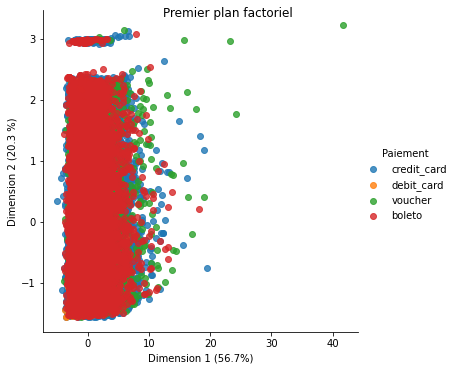

In [190]:
plt.figure(figsize=(15,15))
g_pca = sns.lmplot(x="Dim1", y="Dim2", data = pca_df, hue='Paiement',fit_reg = False)
g_pca.set(xlabel = "Dimension 1 (56.7%)", ylabel = "Dimension 2 (20.3 %)")
g_pca.fig.suptitle("Premier plan factoriel")

Text(0.5, 0.98, 'Premier plan factoriel')

<Figure size 1080x1080 with 0 Axes>

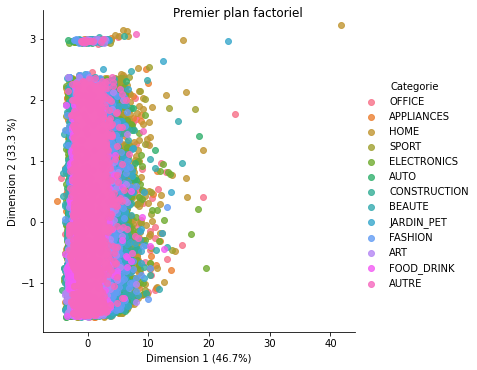

In [191]:
plt.figure(figsize=(15,15))
g_pca = sns.lmplot(x="Dim1", y="Dim2", data = pca_df, hue='Categorie',fit_reg = False)
g_pca.set(xlabel = "Dimension 1 (46.7%)", ylabel = "Dimension 2 (33.3 %)")
g_pca.fig.suptitle("Premier plan factoriel")

In [334]:
data.columns

Index(['customer_id', 'customer_unique_id', 'customer_city', 'customer_state',
       'order_id', 'order_status', 'order_purchase_timestamp',
       'order_delivered_customer_date', 'order_item_id', 'product_id', 'price',
       'freight_value', 'product_category_name_english', 'payment_sequential',
       'payment_type', 'payment_installments', 'payment_value', 'review_score',
       'Durée_livraison', 'Montant_achat', 'Prix_Livraison', 'Prix_produit',
       'Rapport_liv_prod', 'Montant_achatLOG'],
      dtype='object')

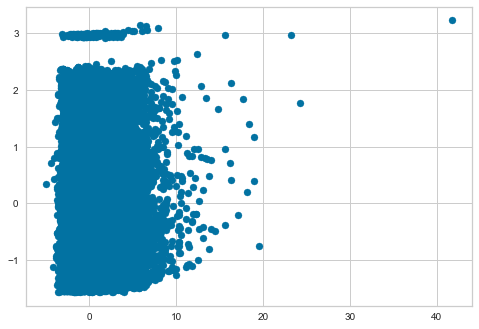

In [335]:
plt.scatter(X_projected[:,0],X_projected[:,1])

# <font color=red > TSNE sur Rio Janeiro   </font>

In [121]:
df1=pd.DataFrame({'Pays':dataEtude['Etat_habitation'].value_counts().index,'Modalite':dataEtude['Etat_habitation'].value_counts().values})

<AxesSubplot:xlabel='Modalite', ylabel='Pays'>

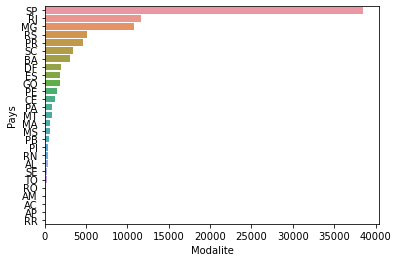

In [122]:
sns.barplot(y='Pays',x='Modalite',data=df1.sort_values('Modalite',ascending=False))

In [123]:
#Nous avons pris l'etat de rio janeiro pour faire 
#notre tsne 
i=dataEtude['Etat_habitation']=='RJ'
data_reduce=dataEtude[i]

In [124]:
data_reduce.shape

(11677, 17)

In [125]:
#data_reduce = dataEtude.sample(10000, random_state=1)

In [126]:
data_reduce.columns

Index(['customer_unique_id', 'date_achat_max', 'Recency', 'Frequence',
       'Somme_depensee', 'Somme_Livraison', 'Somme_Produit',
       'Rapport_prixlivr_prixproduit', 'Somme_depenseeLOG',
       'Somme_LivraisonLOG', 'Somme_ProduitLOG', 'Score_moyen',
       'paiement_plus_utilise_x', 'paiement_plus_utilise_y',
       'Durée_moyen_livraison', 'Etat_habitation', 'Sequence_paiement'],
      dtype='object')

In [127]:
features=['Recency','Frequence','Somme_depenseeLOG','Somme_LivraisonLOG', 'Somme_ProduitLOG']

In [128]:
index=data_reduce.columns.isin(features)

In [129]:
data_reduce_model=data_reduce[data_reduce.columns[index]]

In [130]:
X_reduce=data_reduce_model.values

In [142]:
names=data_reduce_model.index
#nous avons les différents lignes de notre table

In [131]:
from sklearn.preprocessing import StandardScaler
X_reduce_scaled=StandardScaler().fit_transform(X_reduce)

In [133]:
from sklearn.manifold import TSNE

## Perplexity=5

In [311]:
tsne=TSNE(n_components=2,perplexity=5)
X_tsne=tsne.fit_transform(X_reduce_scaled)

In [312]:
df_tsne5=pd.DataFrame({'TSNE 1': X_tsne[:,0],
                     'TSNE 2' : X_tsne[:,1],
                     'Paiement':data_reduce['paiement_plus_utilise'],
                     'Categorie':data_reduce['CATEG_PLUS_ACHETEE'],
                     'Score':data_reduce['Score_moyen']})

In [315]:
df_tsne5.head()

,TSNE 1,TSNE 2,Paiement,Categorie,Score
10,27.030851,-26.693663,credit_card,ELECTRONICS,5.0
15,47.020027,-97.475533,credit_card,AUTO,5.0
32,-83.220703,21.384899,credit_card,HOME,5.0
50,-61.062813,85.525780,debit_card,BEAUTE,5.0
51,-17.649361,-83.294502,voucher,FASHION,1.0


<Figure size 1080x1080 with 0 Axes>

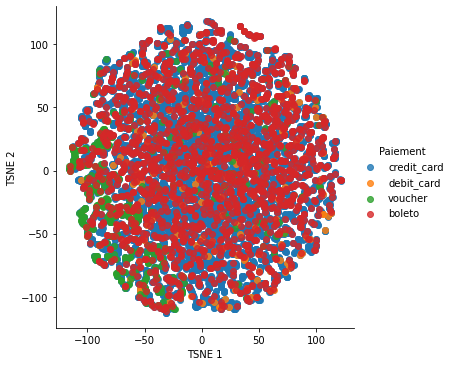

In [314]:
plt.figure(figsize=(15,15))
g_pca = sns.lmplot(x="TSNE 1", y="TSNE 2", data = df_tsne5, hue='Paiement',fit_reg = False)
#g_pca.set(xlabel = "Dimension 1 (46.7%)", ylabel = "Dimension 2 (33.3 %)")
#g_pca.fig.suptitle("Premier plan factoriel")

<Figure size 1080x1080 with 0 Axes>

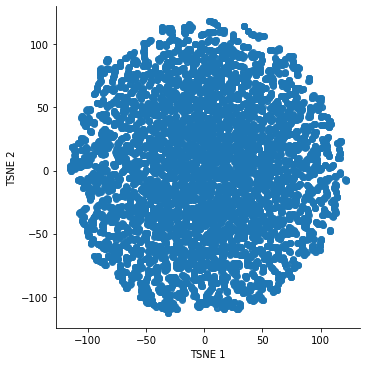

In [317]:
plt.figure(figsize=(15,15))
g_pca = sns.lmplot(x="TSNE 1", y="TSNE 2", data = df_tsne5,fit_reg = False)
#g_pca.set(xlabel = "Dimension 1 (46.7%)", ylabel = "Dimension 2 (33.3 %)")

## Perplixite 30

In [318]:
tsne=TSNE(n_components=2,perplexity=30)
X_tsne30=tsne.fit_transform(X_reduce_scaled)

In [319]:
df_tsne30=pd.DataFrame({'TSNE 1': X_tsne30[:,0],
                     'TSNE 2' : X_tsne30[:,1],
                     'Paiement':data_reduce['paiement_plus_utilise'],
                     'Categorie':data_reduce['CATEG_PLUS_ACHETEE'],
                     'Score':data_reduce['Score_moyen']})

<Figure size 1080x1080 with 0 Axes>

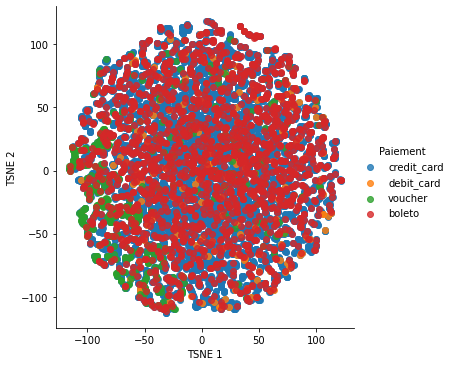

In [320]:
plt.figure(figsize=(15,15))
g_pca = sns.lmplot(x="TSNE 1", y="TSNE 2", data = df_tsne5, hue='Paiement',fit_reg = False)
#g_pca.set(xlabel = "Dimension 1 (46.7%)", ylabel = "Dimension 2 (33.3 %)")
#g_pca.fig.suptitle("Premier plan factoriel")

<Figure size 1080x1080 with 0 Axes>

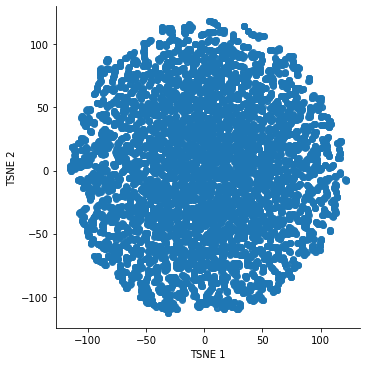

In [322]:
plt.figure(figsize=(15,15))
g_pca = sns.lmplot(x="TSNE 1", y="TSNE 2", data = df_tsne5,fit_reg = False)
#g_pca.set(xlabel = "Dimension 1 (46.7%)", ylabel = "Dimension 2 (33.3 %)")

## Perplexity =50

In [613]:
tsne=TSNE(n_components=2,perplexity=50)
X_tsne50=tsne.fit_transform(X_reduce_scaled)

In [614]:
X_tsne50.shape

(11677, 2)

In [615]:
df_tsne50=pd.DataFrame({'TSNE 1': X_tsne50[:,0],
                     'TSNE 2' : X_tsne50[:,1],
                     'Paiement':data_reduce['paiement_plus_utilise'],
                     'Categorie':data_reduce['CATEG_PLUS_ACHETEE'],
                     'Score':data_reduce['Score_moyen'],
                       'Client' : data_reduce['customer_unique_id']})

<Figure size 1080x1080 with 0 Axes>

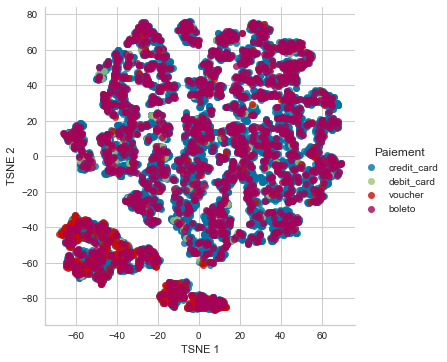

In [616]:
plt.figure(figsize=(15,15))
g_pca = sns.lmplot(x="TSNE 1", y="TSNE 2", hue='Paiement',data = df_tsne50,fit_reg = False)
#g_pca.set(xlabel = "Dimension 1 (46.7%)", ylabel = "Dimension 2 (33.3 %)")
#g_pca.fig.suptitle("Premier plan factoriel")

#  <font color=red > TSNE sur le table entiére   </font>

In [193]:
tsne=TSNE(n_components=2,perplexity=50)
X_tsne50=tsne.fit_transform(X_scaled)

In [194]:
df50=pd.DataFrame({'TSNETotal_1': X_tsne50[:,0],
                     'TSNETotal_2' : X_tsne50[:,1],
                     'Paiement':dataEtude['paiement_plus_utilise'],
                     'Categorie':dataEtude['CATEG_PLUS_ACHETEE'],
                     'Score':dataEtude['Score_moyen'],
                       'Client' : dataEtude['customer_unique_id']})

<Figure size 1080x1080 with 0 Axes>

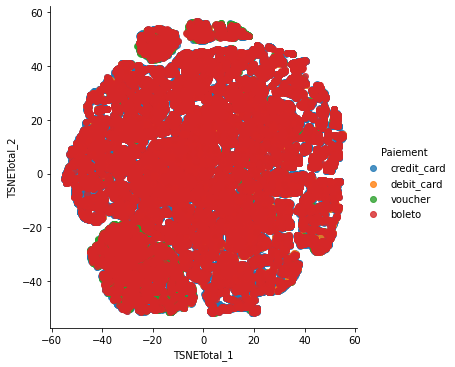

In [195]:
plt.figure(figsize=(15,15))
g_pca = sns.lmplot(x="TSNETotal_1", y="TSNETotal_2", hue='Paiement',data = df50,fit_reg = False)

<Figure size 1080x1080 with 0 Axes>

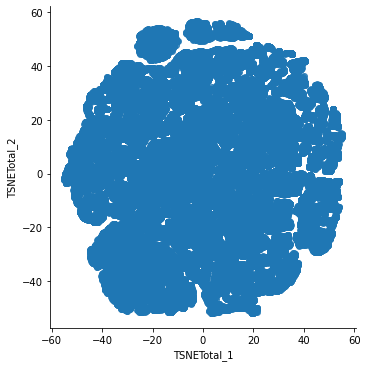

In [196]:
plt.figure(figsize=(15,15))
g_pca = sns.lmplot(x="TSNETotal_1", y="TSNETotal_2",data = df50,fit_reg = False)

# <font color=red> Choix nombre cluster grâce à la CAH  </font>

In [146]:
names #les différents lignes de notre table de rio janeiro

Int64Index([   10,    15,    32,    50,    51,    61,    70,    78,    86,
               93,
            ...
            91620, 91630, 91650, 91659, 91681, 91688, 91689, 91692, 91701,
            91716],
           dtype='int64', length=11677)

In [149]:
data_reduce_model.head()

,Recency,Frequence,Somme_depenseeLOG,Somme_LivraisonLOG,Somme_ProduitLOG
10,203,1,2.185060,1.366049,2.113609
15,15,1,2.136499,1.231215,2.078819
32,440,6,2.987000,2.376248,2.864920
50,110,1,1.858898,1.261501,1.732394
51,445,2,3.209354,1.629002,3.197788


In [148]:
X_reduce_scaled #les données centres et reduites de notre
#recence frequence, somme totale depense en produit et en livraiison 

array([[-0.28472235, -0.29646325,  0.19475968,  0.0111331 ,  0.26346144],
       [-1.51874125, -0.29646325,  0.06518956, -0.48206966,  0.18185188],
       [ 1.27092913,  5.50803267,  2.33445994,  3.70627635,  2.02587078],
       ...,
       [ 0.92304082, -0.29646325, -0.81615207, -0.78199591, -0.71122966],
       [-0.6851221 , -0.29646325,  0.23820315, -1.49695449,  0.40996269],
       [-0.19282733,  3.1862343 ,  0.82589501,  2.06435403,  0.59237073]])

In [150]:
from scipy.cluster.hierarchy import linkage, fcluster
#utilisation modules pour les cluster de partitionnement

In [151]:
#clustering hierarchique
Z=linkage(X_reduce_scaled,'ward')
#methode ward permet de minimiser l'inertie intraclasse

In [161]:
names=names.astype('int')



In [153]:
from scipy.cluster.hierarchy import dendrogram

In [162]:
type(names)

pandas.core.indexes.numeric.Int64Index

In [166]:

#https://desktop.arcgis.com/fr/arcmap/10.3/tools/spatial-analyst-toolbox/how-dendrogram-works.htm
def plot_dendrogram(Z, names):
    plt.figure(figsize=(10,25))
    plt.title('Hierarchical Clustering Dendrogram')
    plt.xlabel('distance')
    dendrogram(
        Z,
        labels = names,
        orientation = "bottom",
    )
    plt.show()

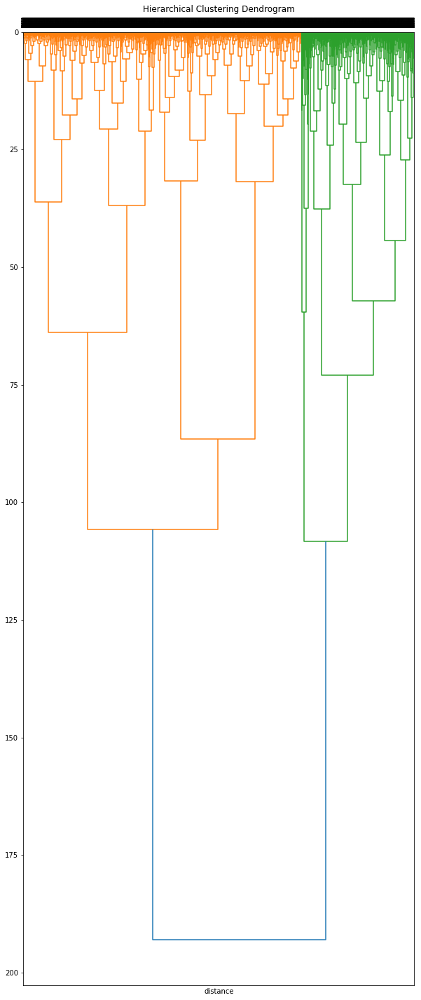

In [167]:
plot_dendrogram(Z,names)

# <font color=red> K-means choix nombre cluster  </font>

##  la métrique  silhouette

In [100]:
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
from sklearn import metrics, cluster

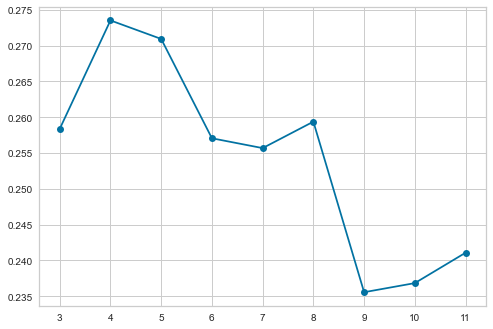

In [433]:
#n_init le nombre dexecution on le laisse 10
#max_iter on le laisse a 300
#init on le laisse a kmeans++ ca place les centres des points le plus eloigne 
#au lieu de faire cls.labels_ on peut faire predict(X)
from sklearn import metrics, cluster
silhouette=[]
for nbcluster in range(3,12):
    cls=cluster.KMeans(n_clusters=nbcluster,n_init=1,init='random')
    cls.fit(X_scaled)
    silh=metrics.silhouette_score(X_scaled,cls.labels_)
    silhouette.append(silh)
plt.plot(range(3,12),silhouette,marker='o')

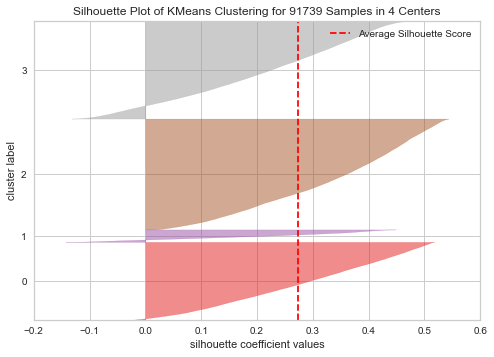

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 91739 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [427]:
model = cluster.KMeans(4)
visualizer = SilhouetteVisualizer(model)
visualizer.fit(X_scaled)
visualizer.poof()   

## Avec la métrique variance des clusters  

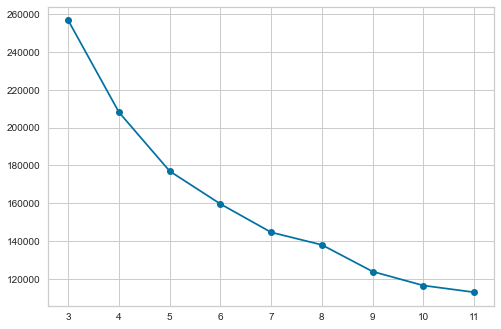

In [196]:
distortions = []
K = range(3,12)
for k in K:
    kmeanModel = cluster.KMeans(n_clusters=k,n_init=1,init='random')
    kmeanModel.fit(X_scaled)
    distortions.append(kmeanModel.inertia_)
plt.plot(range(3,12),distortions,marker='o')

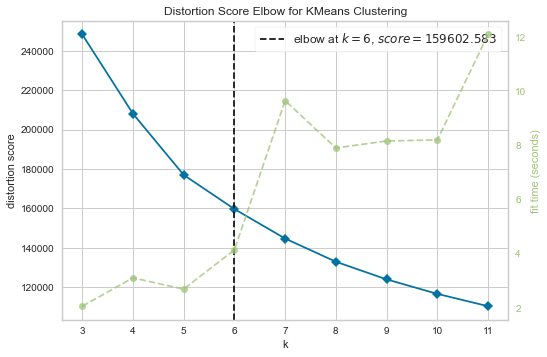

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [197]:
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
model = cluster.KMeans()
visualizer = KElbowVisualizer(model, k=(3,12))

visualizer.fit(X_scaled)   
visualizer.poof() 
#on prend la Somme des distances au carré des échantillons à 
#leur centre de cluster le plus proche.
#inertia_


## Avec la métrique Calinski harabasz

Text(0, 0.5, 'Rapport de variance')

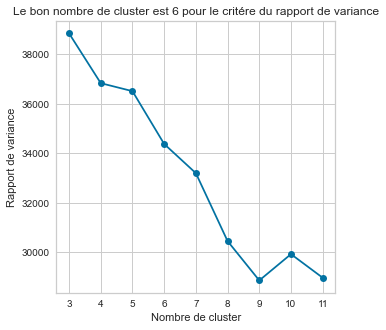

In [199]:
from sklearn import metrics, cluster
calinski=[]
for nbcluster in range(3,12):
    cls=cluster.KMeans(n_clusters=nbcluster,n_init=1,init='random')
    cls.fit(X_scaled)
    cal=metrics.calinski_harabasz_score(X_scaled,cls.labels_)
    calinski.append(cal)
plt.figure(figsize=(5,5))
plt.plot(range(3,12),calinski,marker='o')
plt.title('Le bon nombre de cluster est 6 pour le critére du rapport de variance')
plt.xlabel('Nombre de cluster')
plt.ylabel('Rapport de variance')

##  Avec la métrique Davies Bouldin

$DB=1/K \sum \limits_{k=1}^{k} D_{k}$

$DK= max T_{k}+T_{l} / S_{kl}$

Text(0, 0.5, 'Moyenne de similarite')

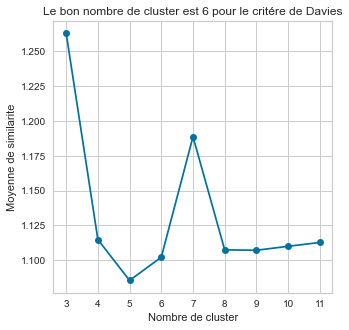

In [200]:
from sklearn import metrics, cluster
davies=[]
for nbcluster in range(3,12):
    cls=cluster.KMeans(n_clusters=nbcluster,n_init=1,init='random')
    cls.fit(X_scaled)
    dav=metrics.davies_bouldin_score(X_scaled,cls.labels_)
    davies.append(dav)
plt.figure(figsize=(5,5))
plt.plot(range(3,12),davies,marker='o')
plt.title('Le bon nombre de cluster est 6 pour le critére de Davies')
plt.xlabel('Nombre de cluster')
plt.ylabel('Moyenne de similarite')

# <font color=red > Réalisation du K-means  </font>

In [218]:
my_clust=cluster.KMeans(n_clusters=6)
my_clust.fit(X_scaled)


KMeans(n_clusters=6)

In [219]:
dataModel.columns

Index(['customer_unique_id', 'Recency', 'Frequence', 'Somme_depenseeLOG',
       'Somme_LivraisonLOG', 'Somme_ProduitLOG'],
      dtype='object')

In [220]:
labels = pd.DataFrame(my_clust.labels_)
dataModel = dataModel.assign(Cluster=labels)
#permet de créer une nouvelle colonne avec assign
#dataModel['Cluster']=labels

In [196]:
dataModel.columns

Index(['customer_unique_id', 'Recency', 'Frequence', 'Somme_depenseeLOG',
       'Somme_LivraisonLOG', 'Somme_ProduitLOG', 'Cluster'],
      dtype='object')

In [197]:
my_clust.cluster_centers_#ce sont les coordonnées des
#6 centres 

array([[ 1.05933554, -0.25225997, -0.77359785, -0.5302266 , -0.75957876],
       [-0.663824  , -0.18907589,  0.17027157, -0.07939436,  0.21640092],
       [ 0.0520234 ,  4.97931392,  2.25700341,  3.17558033,  1.96319613],
       [ 1.1084721 , -0.09006095,  0.50993286,  0.11670266,  0.5429247 ],
       [-0.25514184,  0.6001327 ,  1.43641856,  1.40562557,  1.33730097],
       [-0.64076062, -0.26678831, -1.05249643, -0.68580606, -1.06442848]])

In [198]:
dataModel.head()

,customer_unique_id,Recency,Frequence,Somme_depenseeLOG,Somme_LivraisonLOG,Somme_ProduitLOG,Cluster
0,861eff4711a542e4b93843c6dd7febb0,469,1,2.166933,1.340047,2.096875,3
1,290c77bc529b7ac935b93aa66c333dc3,228,1,2.525667,1.667266,2.460898,4
2,060e732b5b29e8181a18229c7b0b2b5e,101,1,2.197914,1.250176,2.145942,1
3,259dac757896d24d7702b9acbbff3f3c,168,1,2.238799,1.368473,2.175918,1
4,345ecd01c38d18a9036ed96c73b8d066,31,1,2.401831,1.347330,2.361728,1


## Representation avec les variables

In [205]:
def scatters(data, h=None, pal=None):
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8))
    pal = ['red', 'black', 'green', 'blue', 'yellow', 'violet']
    sns.scatterplot(y="Recency", x="Somme_ProduitLOG", hue=h,
                    palette=pal, data=dataModel, ax=ax1)
    sns.scatterplot(x="Somme_LivraisonLOG", y="Somme_depenseeLOG",
                    hue=h, palette=pal, data=dataModel, ax=ax2)
    #sns.scatterplot(x="Credit amount",y="Duration", hue=h, palette=pal, data=data, ax=ax1)
    #sns.scatterplot(x="Age",y="Credit amount", hue=h, palette=pal, data=data, ax=ax2)
    #sns.scatterplot(x="Age",y="Duration", hue=h, palette=pal, data=data, ax=ax3)
    # plt.tight_layout()

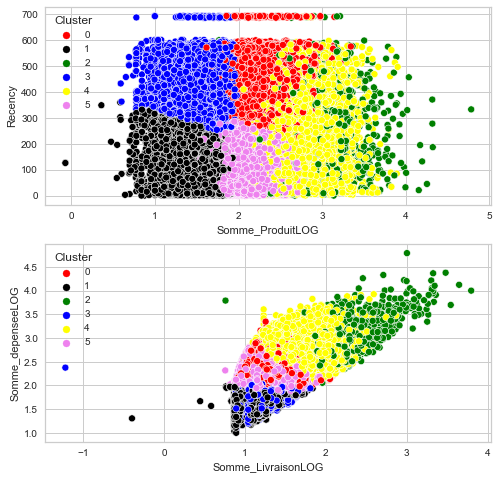

In [206]:
scatters(dataModel,'Cluster')

## Representation avec les ACP

Text(0, 0.5, 'Composante 2 avec 20.3 %')

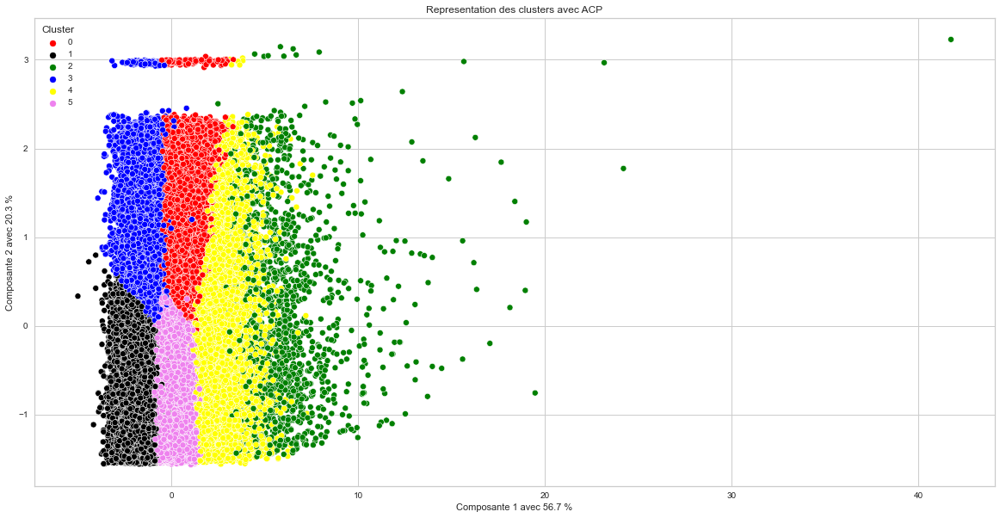

In [207]:
plt.figure(figsize=(20,10))
sns.scatterplot(x=X_projected[:, 0], y=X_projected[:, 1],hue='Cluster',data=dataModel,\
                palette=['red','black','green','blue','yellow','violet'])

plt.title('Representation des clusters avec ACP')
plt.xlabel('Composante 1 avec 56.7 %')
plt.ylabel('Composante 2 avec 20.3 %')

## Representation avec TSNE

Text(0.5, 1.0, 'Representation des clusters avec la projection TSNE')

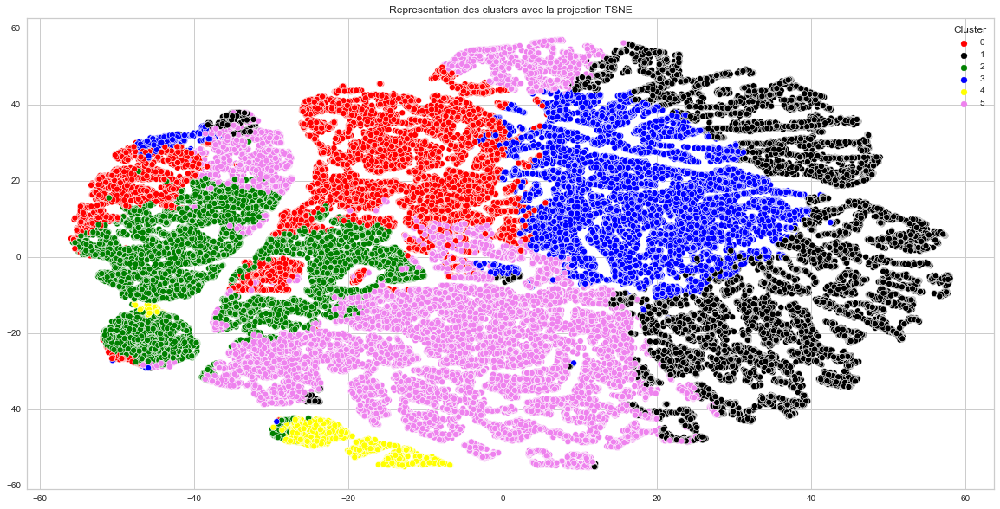

In [359]:
plt.figure(figsize=(20,10))
sns.scatterplot(x=X_tsne50[:, 0], y=X_tsne50[:, 1],hue='Cluster',data=dataModel,\
                palette=['red','black','green','blue','yellow','violet'])
plt.title('Representation des clusters avec la projection TSNE')

In [199]:
dataModel=dataModel.set_index(['customer_unique_id'])

In [200]:
dataModel.head()

,Recency,Frequence,Somme_depenseeLOG,Somme_LivraisonLOG,Somme_ProduitLOG,Cluster
customer_unique_id,,,,,,
861eff4711a542e4b93843c6dd7febb0,469,1,2.166933,1.340047,2.096875,3
290c77bc529b7ac935b93aa66c333dc3,228,1,2.525667,1.667266,2.460898,4
060e732b5b29e8181a18229c7b0b2b5e,101,1,2.197914,1.250176,2.145942,1
259dac757896d24d7702b9acbbff3f3c,168,1,2.238799,1.368473,2.175918,1
345ecd01c38d18a9036ed96c73b8d066,31,1,2.401831,1.347330,2.361728,1


In [201]:
import plotly.express as px

fig = px.scatter(dataModel, x="Recency",y="Somme_ProduitLOG", color="Cluster")
fig.show()

# <font color=red > Interpretation cluster  </font>

In [202]:
dataModel['Somme_depense']=MTR.inverse_transform(dataModel['Somme_depenseeLOG'])
dataModel['Somme_Livraison']=MTR.inverse_transform(dataModel['Somme_LivraisonLOG'])
dataModel['Somme_Produit']=MTR.inverse_transform(dataModel['Somme_ProduitLOG'])

In [204]:
dataModel.groupby('Cluster')[['Recency','Frequence','Somme_depense','Somme_Livraison','Somme_Produit']].mean().round(1)
#round permet d'arrondir au virgule
#voir le power point pour l'interpretation 

,Recency,Frequence,Somme_depense,Somme_Livraison,Somme_Produit
Cluster,,,,,
0,398.2,1.0,65.0,15.4,49.6
1,135.3,1.1,150.9,21.8,129.1
2,244.6,5.5,1383.3,250.4,1132.9
3,406.0,1.2,210.8,25.1,185.7
4,197.9,1.7,536.8,63.8,473.0
5,138.7,1.0,50.6,14.1,36.5


In [205]:
dataModel['Cluster'].value_counts()

1    27035
5    19619
0    16632
3    14414
4    12349
2     1690
Name: Cluster, dtype: int64

In [206]:
df=pd.DataFrame({'Cluster':dataModel['Cluster'].value_counts().index,'Nombre de clients':dataModel['Cluster'].value_counts().values})

Text(0.5, 1.0, 'Le cluster 5 contient plus de clients')

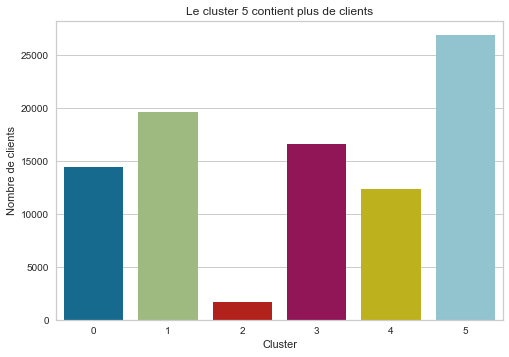

In [228]:
plt.figure()
sns.barplot(x='Cluster',y='Nombre de clients',data=df.sort_values('Cluster',ascending=False))
plt.title('Le cluster 5 contient plus de clients')

# <font color=red > Stabilité Cluster  </font>

In [210]:
#mon premier cluster 
#my_clust.cluster_centers_[:,0]
#my_clust.cluster_centers_[0,:]#coordonnées 1 centre 
my_clust.cluster_centers_
#on a 6 clusters et leurs coordonnes pour les 5 features

array([[ 1.05933554, -0.25225997, -0.77359785, -0.5302266 , -0.75957876],
       [-0.663824  , -0.18907589,  0.17027157, -0.07939436,  0.21640092],
       [ 0.0520234 ,  4.97931392,  2.25700341,  3.17558033,  1.96319613],
       [ 1.1084721 , -0.09006095,  0.50993286,  0.11670266,  0.5429247 ],
       [-0.25514184,  0.6001327 ,  1.43641856,  1.40562557,  1.33730097],
       [-0.64076062, -0.26678831, -1.05249643, -0.68580606, -1.06442848]])

In [213]:
features

Index(['Recency', 'Frequence', 'Somme_depenseeLOG', 'Somme_LivraisonLOG',
       'Somme_ProduitLOG'],
      dtype='object')

In [388]:
from sklearn import metrics
df = pd.DataFrame()
for i in range(200):
    test = cluster.KMeans(n_clusters=6)
    test.fit(X_scaled)
    ari = metrics.adjusted_rand_score(my_clust.labels_, test.labels_)
    test = pd.DataFrame(test.cluster_centers_)
    test.columns = ['RecencyCor', 'FrequenceCor', 'Somme_depenseeLOGCor',
                    'Somme_LivraisonLOGCor', 'Somme_ProduitLOGCor']
    test['indice'] = i
    test['ari'] = ari
    # Calcul du rand score qui doit etre proche de 1
    # car ils sont choisis aleatoirement
    df = pd.concat([df, test])

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning:

overflow encountered in longlong_scalars

C:\Users\soule\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:389: RuntimeWarning:

overflow encountered

In [392]:
df.describe()


,RecencyCor,FrequenceCor,Somme_depenseeLOGCor,Somme_LivraisonLOGCor,Somme_ProduitLOGCor,indice,ari
count,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000
mean,0.109580,0.798560,0.425120,0.568178,0.373086,99.500000,-2.809200
std,0.729786,1.897334,1.160726,1.350185,1.069890,57.758376,0.035147
min,-0.671917,-0.266971,-1.053457,-0.686223,-1.065534,0.000000,-2.880262
25%,-0.647387,-0.252603,-0.779484,-0.533488,-0.765898,49.750000,-2.836157
50%,-0.093920,-0.141197,0.336005,0.017318,0.375651,99.500000,-2.806459
75%,1.051463,0.606200,1.442361,1.409285,1.342605,149.250000,-2.780108
max,1.119897,5.004192,2.264635,3.187277,1.969668,199.000000,-2.753873


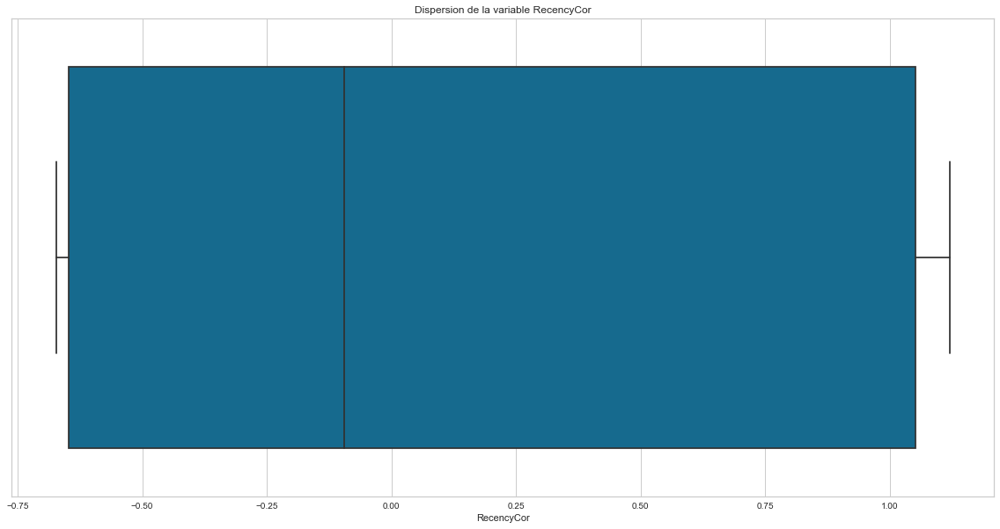

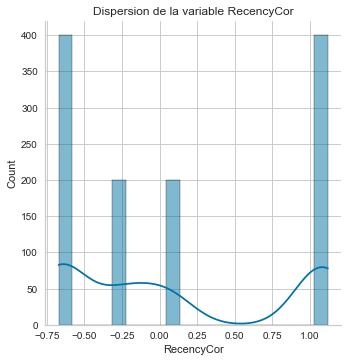

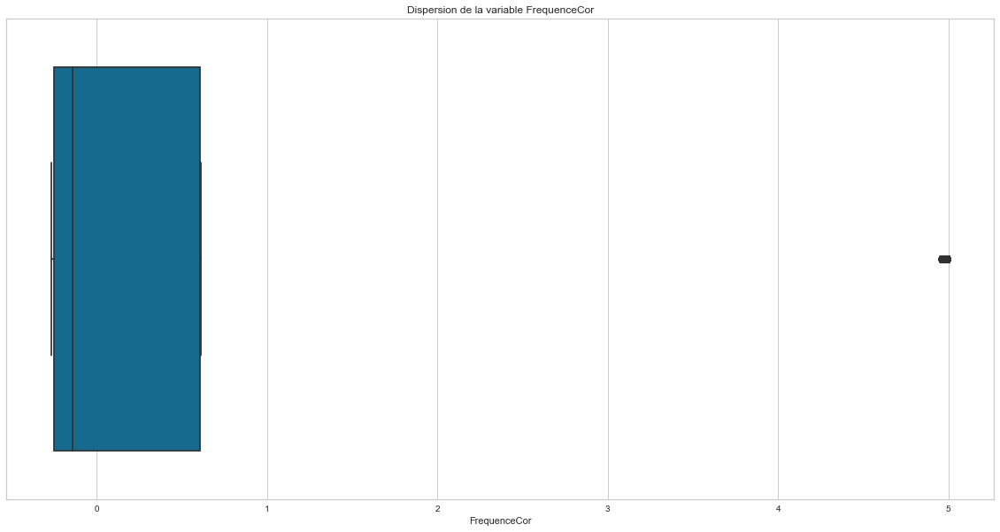

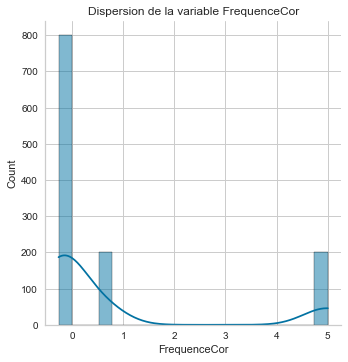

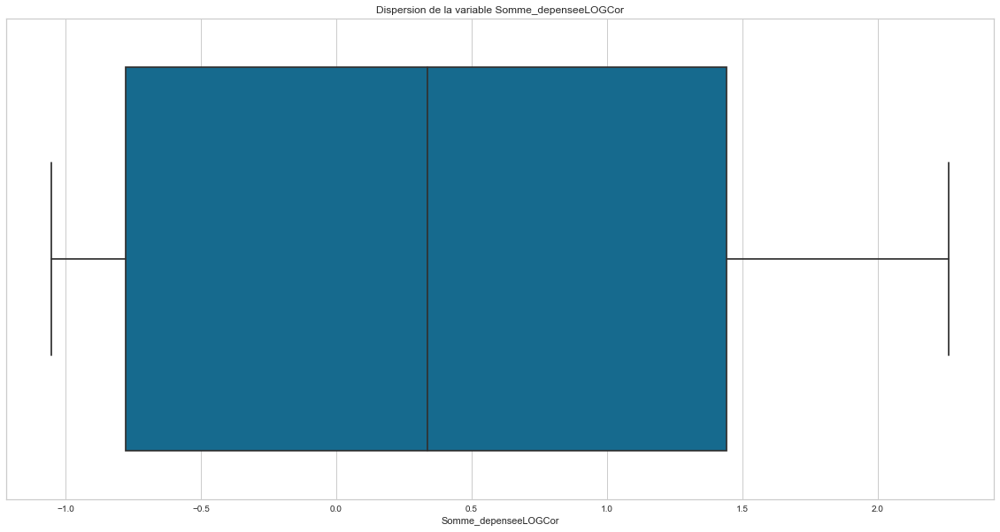

...

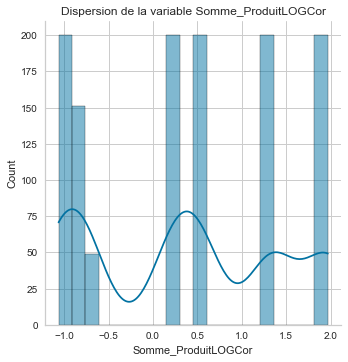

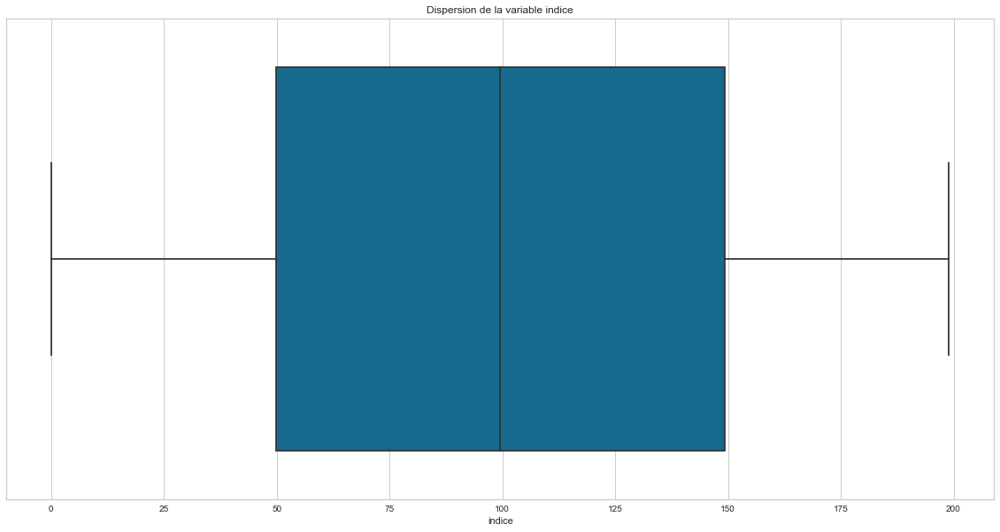

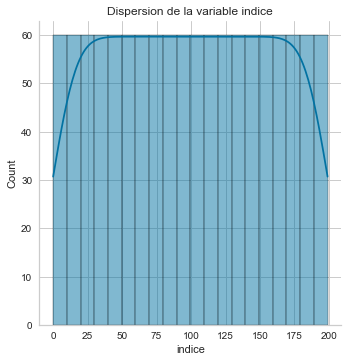

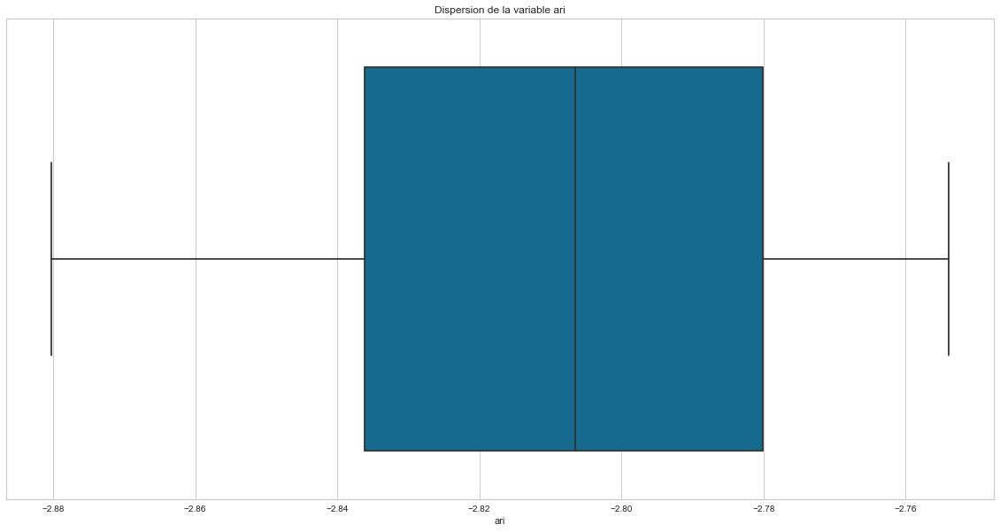

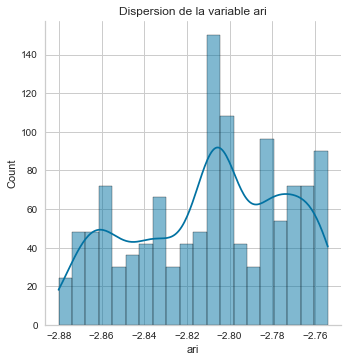

In [404]:
for col in df.columns:
    TraceGraphique(df,col)

<AxesSubplot:>

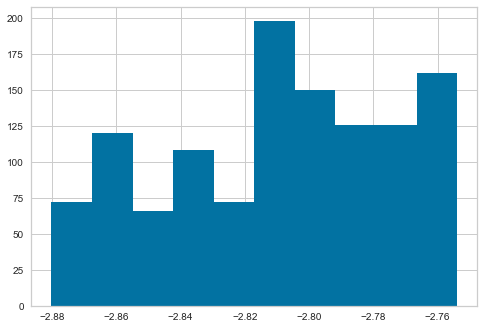

In [394]:
df['ari'].hist()
#nous avons des valeurs d'ari negatifs ce qui n'est pas normal 
#nous allons utilisés google colab qui nous donne des ari positifs
#c'est ce graphe qu'on trouve sur notre présentation
#https://stackoverflow.com/questions/42418773/how-can-we-interpret-negative-adjusted-rand-index

#  <font color=red > Performance Cluster  </font>

In [177]:
print('Le coefficient de silhouette kmeans pour le RFM est',metrics.silhouette_score(X_scaled,my_clust.labels_))

Le coefficient de silhouette kmeans pour le RFM est 0.25723888726349664


In [218]:
print('Le coefficient de davies bouldin kmeans pour le RFM est',metrics.davies_bouldin_score(X_scaled,my_clust.labels_))
#un davies faible implique des clusters homogenes 

Le coefficient de davies bouldin kmeans pour le RFM est 1.1001969054186318


In [180]:
my_clust.inertia_
#fonction cout du modéle 
#somme des distances entre les points d'un cluster 
#et le centroide

159602.9757762361

# <font color=red > k-means sur les composantes ACP  </font> 

In [217]:
X_projected

array([[ 0.18896802,  1.5146541 , -0.4241918 , -0.12956984],
       [ 1.7300816 , -0.07322459, -0.80406722, -0.64027092],
       [ 0.1586586 , -0.88863187, -0.55359547,  0.22814638],
       ...,
       [-1.16276263, -0.63289217,  0.47087994, -0.37619359],
       [ 2.11851615,  0.41009671, -1.79052986,  0.58702794],
       [-2.95041743,  0.10613477,  0.91259734,  0.27419269]])

In [218]:
X_projected.shape

(91739, 4)

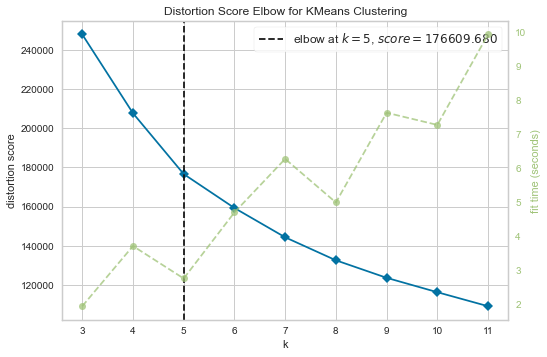

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [254]:
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
model = cluster.KMeans()
visualizer = KElbowVisualizer(model, k=(3,12))

visualizer.fit(X_projected)    # Fit the data to the visualizer
visualizer.poof() 
#on prend la Somme des distances au carré des échantillons à 
#leur centre de cluster le plus proche.
#inertia_

In [219]:
clsacp=cluster.KMeans(n_clusters=5)
clsacp.fit(X_projected)


KMeans(n_clusters=5)

In [222]:
my_clust.cluster_centers_

array([[ 1.05933554, -0.25225997, -0.77359785, -0.5302266 , -0.75957876],
       [-0.663824  , -0.18907589,  0.17027157, -0.07939436,  0.21640092],
       [ 0.0520234 ,  4.97931392,  2.25700341,  3.17558033,  1.96319613],
       [ 1.1084721 , -0.09006095,  0.50993286,  0.11670266,  0.5429247 ],
       [-0.25514184,  0.6001327 ,  1.43641856,  1.40562557,  1.33730097],
       [-0.64076062, -0.26678831, -1.05249643, -0.68580606, -1.06442848]])

In [223]:
clsacp.cluster_centers_[:,0]#coordonnées 1 centre 

array([ 0.11763456, -0.40994816,  5.67762527,  2.25981843, -1.63501775])

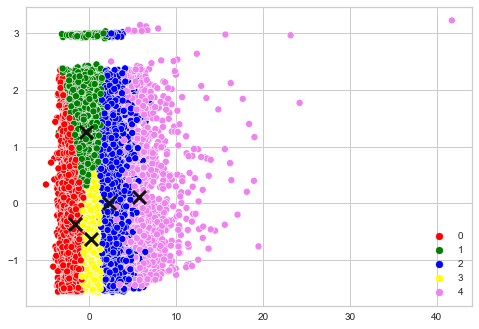

In [437]:
sns.scatterplot(x=X_projected[:,0],y=X_projected[:,1],hue=clsacp.labels_,data=dataModel,palette=['red','green','blue','yellow','violet'])

#pour le tracé des centres 
plt.scatter(clsacp.cluster_centers_[:, 0], clsacp.cluster_centers_[:, 1],
            marker='x', s=169, linewidths=3,
            color='k', zorder=10)


# <font color=red > Création features pour la segmentation </font>

In [225]:
dataEtude.columns

Index(['customer_unique_id', 'date_achat_max', 'Recency', 'Frequence',
       'Somme_depensee', 'Somme_Livraison', 'Somme_Produit',
       'Rapport_prixlivr_prixproduit', 'Somme_depenseeLOG',
       'Somme_LivraisonLOG', 'Somme_ProduitLOG', 'Score_moyen',
       'paiement_plus_utilise', 'Durée_moyen_livraison', 'Etat_habitation',
       'Sequence_paiement', 'CATEG_PLUS_ACHETEE'],
      dtype='object')

## Features sur les dates

In [87]:
dataEtude['date_achat_max']=pd.to_datetime(dataEtude['date_achat_max'])

In [88]:
#https://www.dataquest.io/blog/python-datetime-tutorial/
#https://www.justintodata.com/manipulate-date-and-time-in-python/
from datetime import datetime

In [89]:
dataEtude['Année']=dataEtude['date_achat_max'].dt.year

In [168]:
dataModel.shape

(91739, 6)

In [92]:
dataEtude['Date']=dataEtude['date_achat_max'].dt.strftime( "%Y-%m-%d")

In [93]:
dataEtude['Date']=pd.to_datetime(dataEtude['Date'])

In [94]:
dataEtude['Mois_année']=dataEtude['date_achat_max'].dt.strftime( "%B-%Y")
#dataEtude['Mois_année']=pd.to_datetime(dataEtude['Mois_année'])

In [95]:
dataEtude['Mois_année']

0             May-2017
1         January-2018
2             May-2018
3           March-2018
4            July-2018
             ...      
91734       April-2018
91735       April-2018
91736       April-2018
91737    November-2017
91738    December-2017
Name: Mois_année, Length: 91739, dtype: object

In [96]:
dataEtude['Heure_achat']=dataEtude['date_achat_max'].dt.hour

In [97]:
dataEtude['Heure_achat'].describe()
#en moyenne nos clients commandent vers les environs de 15h
#mediane > moyenne la pluspart des commandes sont infenieurs a 14h
#le plus tard qu'un client commande est minuit 

count    91739.000000
mean        14.788640
std          5.320982
min          0.000000
25%         11.000000
50%         15.000000
75%         19.000000
max         23.000000
Name: Heure_achat, dtype: float64

In [98]:
l=['October-2016','January-2017','February-2017','March-2017','April-2017','May-2017',\
 'June-2017','July-2017','August-2017','September-2017','October-2017','November-2017','December-2017',\
 'January-2018', 'February-2018','March-2018','April-2018','May-2018','June-2018','July-2018',\
  'August-2018']
#reindex permet de mettre dans l'ordre 
dataEtude['Mois_année'].value_counts().reindex(l)

October-2016       251
January-2017       679
February-2017     1538
March-2017        2377
April-2017        2135
May-2017          3277
June-2017         2914
July-2017         3635
August-2017       3907
September-2017    3896
October-2017      4250
November-2017     6937
December-2017     5231
January-2018      6675
February-2018     6188
March-2018        6710
April-2018        6449
May-2018          6405
June-2018         5993
July-2018         6016
August-2018       6276
Name: Mois_année, dtype: int64

In [232]:
df3=pd.DataFrame({'Mois':dataEtude['Mois_année'].value_counts().reindex(l).index,'Commande':dataEtude['Mois_année'].value_counts().reindex(l).values})

Text(0.5, 1.0, 'Augmentation des ventes en novembre 2017')

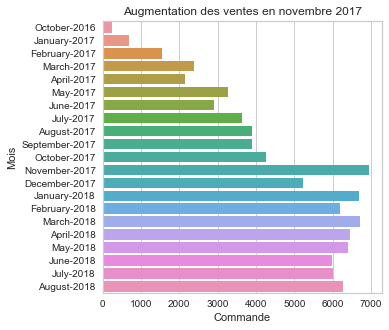

In [233]:
plt.figure(figsize=(5,5))
sns.barplot(y='Mois',x='Commande',data=df3)
plt.title('Augmentation des ventes en novembre 2017')

Text(0.5, 1.0, 'Une augmentation des commandes en novembre 2017')

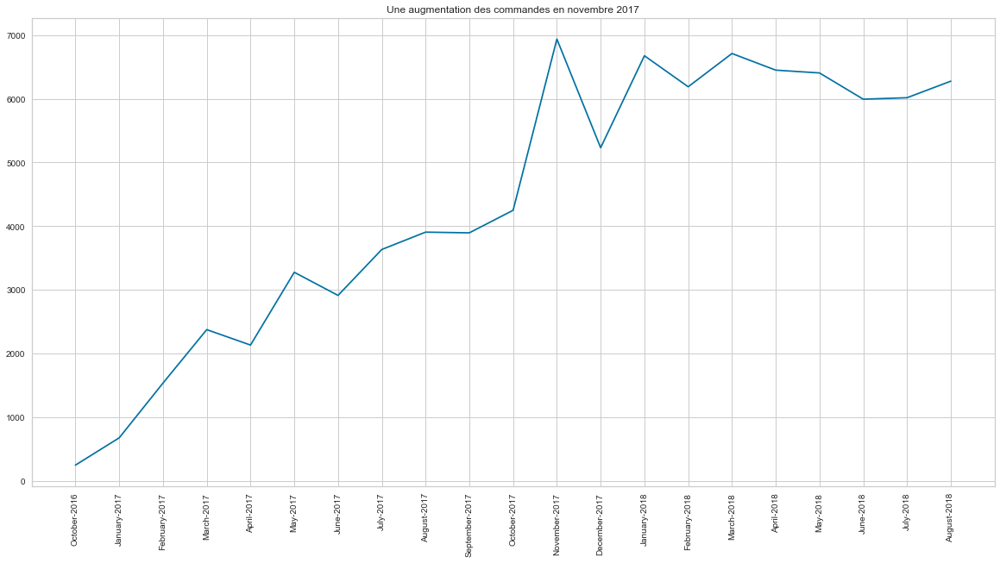

In [240]:
plt.figure(figsize=(20,10))
plt.plot(df3['Mois'],df3['Commande']);
plt.xticks(rotation=90);
plt.title('Une augmentation des commandes en novembre 2017')
#https://brazil-selection.com/lactu-bresil/2017/01/20/jours-feries-bresil/

In [241]:
dataModel.columns

Index(['Recency', 'Frequence', 'Somme_depenseeLOG', 'Somme_LivraisonLOG',
       'Somme_ProduitLOG', 'Cluster', 'Somme_depense', 'Somme_Livraison',
       'Somme_Produit'],
      dtype='object')

In [124]:
dataEtude.head()

,customer_unique_id,date_achat_max,Recency,Frequence,Somme_depensee,Somme_Livraison,Somme_Produit,Rapport_prixlivr_prixproduit,Somme_depenseeLOG,Somme_LivraisonLOG,...,Score_moyen,CATEG_PLUS_ACHETEE,paiement_plus_utilise,Durée_moyen_livraison,Etat_habitation,Sequence_paiement,Année,Date,Mois_année,Heure_achat
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16 15:05:35,469,1,146.87,21.88,124.99,0.175054,2.166933,1.340047,...,4.0,OFFICE,credit_card,8.0,SP,2.0,2017,2017-05-16,May-2017,15
1,290c77bc529b7ac935b93aa66c333dc3,2018-01-12 20:48:24,228,1,335.48,46.48,289.00,0.160830,2.525667,1.667266,...,5.0,APPLIANCES,credit_card,16.0,SP,8.0,2018,2018-01-12,January-2018,20
2,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19 16:07:45,101,1,157.73,17.79,139.94,0.127126,2.197914,1.250176,...,5.0,OFFICE,credit_card,26.0,SP,7.0,2018,2018-05-19,May-2018,16
3,259dac757896d24d7702b9acbbff3f3c,2018-03-13 16:06:38,168,1,173.30,23.36,149.94,0.155796,2.238799,1.368473,...,5.0,OFFICE,credit_card,14.0,SP,1.0,2018,2018-03-13,March-2018,16
4,345ecd01c38d18a9036ed96c73b8d066,2018-07-29 09:51:30,31,1,252.25,22.25,230.00,0.096739,2.401831,1.347330,...,5.0,HOME,credit_card,11.0,SP,8.0,2018,2018-07-29,July-2018,9


# <font color=red > Stabilité temporelle silhouette </font>

## Kmeans sur 2017

In [242]:
i=dataEtude['Année']==2017
data2017=dataEtude[i]

In [243]:
features = ['Recency', 'Frequence', 'Somme_depenseeLOG',
            'Somme_LivraisonLOG', 'Somme_Produit']
index = data2017.columns.isin(features)
dataModel2017 = data2017[data2017.columns[index]]

In [244]:
# Standarisation
from sklearn.preprocessing import StandardScaler
X2017 = dataModel2017.values
X_scaled2017 = StandardScaler().fit_transform(X2017)

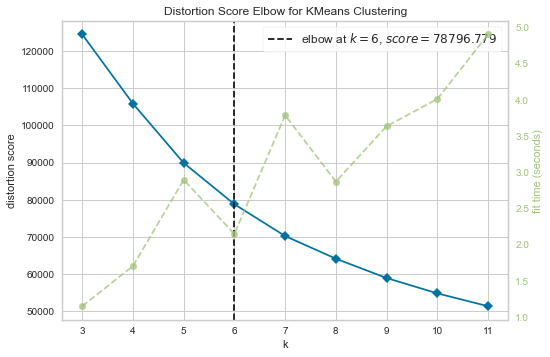

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [245]:
# on va regarder le nombre de cluster avec la methode eblow
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
model = cluster.KMeans()
visualizer = KElbowVisualizer(model, k=(3, 12))

visualizer.fit(X_scaled2017)    # Fit the data to the visualizer
visualizer.poof()
# on prend la Somme des distances au carré des échantillons à
# leur centre de cluster le plus proche.
# inertia_

In [248]:
my_clust2017 = cluster.KMeans(n_clusters=6)
my_clust2017.fit(X_scaled2017)

KMeans(n_clusters=6)

In [249]:
silh2017 = metrics.silhouette_score(X_scaled2017, my_clust2017.labels_)

In [250]:
print(silh2017)

0.31266932981032675


## 2017 + janvier 2018

In [251]:
i=dataEtude['Mois_année']=='January-2018'
J2018=dataEtude[i]

In [252]:
data2017J=pd.merge(J2018,data2017,how='outer')

In [253]:
from sklearn.preprocessing import StandardScaler
features = ['Recency', 'Frequence', 'Somme_depenseeLOG',
            'Somme_LivraisonLOG', 'Somme_Produit']
index = data2017J.columns.isin(features)
dataModel2017J = data2017J[data2017J.columns[index]]
# Standarisation
X2017J = dataModel2017J.values
X_scaled2017J = StandardScaler().fit_transform(X2017J)
Janvier2018 = cluster.KMeans(n_clusters=6)
Janvier2018.fit(X_scaled2017J)
silhjanvier = metrics.silhouette_score(X_scaled2017J, Janvier2018.labels_)

## 2017+ mois 2018

In [254]:
from sklearn.preprocessing import StandardScaler
i = dataEtude['Mois_année'] == 'February-2018'
F2018 = dataEtude[i]
data2017F = pd.merge(F2018, data2017J, how='outer')
########
features = ['Recency', 'Frequence', 'Somme_depenseeLOG',
            'Somme_LivraisonLOG', 'Somme_Produit']
index = data2017F.columns.isin(features)
dataModel2017F = data2017F[data2017F.columns[index]]
# Standarisation
X2017F = dataModel2017F.values
X_scaled2017F = StandardScaler().fit_transform(X2017F)
Fevrier2018 = cluster.KMeans(n_clusters=6)
Fevrier2018.fit(X_scaled2017F)
silhfevrier = metrics.silhouette_score(X_scaled2017F, Fevrier2018.labels_)

In [229]:
i = dataEtude['Mois_année'] == 'March-2018'
M2018 = dataEtude[i]
data2017M = pd.merge(M2018, data2017F, how='outer')
########
features = ['Recency', 'Frequence', 'Somme_depenseeLOG',
            'Somme_LivraisonLOG', 'Somme_Produit']
index = data2017M.columns.isin(features)
dataModel2017M = data2017M[data2017M.columns[index]]
# Standarisation
X2017M = dataModel2017M.values
X_scaled2017M = StandardScaler().fit_transform(X2017M)
# modele
mars2018 = cluster.KMeans(n_clusters=6)
mars2018.fit(X_scaled2017M)
silhmars = metrics.silhouette_score(X_scaled2017M, mars2018.labels_)

In [233]:
i = dataEtude['Mois_année'] == 'April-2018'
A2018 = dataEtude[i]
data2017A = pd.merge(A2018, data2017M, how='outer')
########
features = ['Recency', 'Frequence', 'Somme_depenseeLOG',
            'Somme_LivraisonLOG', 'Somme_Produit']
index = data2017A.columns.isin(features)
dataModel2017A = data2017A[data2017A.columns[index]]
# Standarisation
X2017A = dataModel2017A.values
X_scaled2017A = StandardScaler().fit_transform(X2017A)
# modele
avril2018 = cluster.KMeans(n_clusters=6)
avril2018.fit(X_scaled2017A)
silhavril = metrics.silhouette_score(X_scaled2017A, avril2018.labels_)

In [235]:
i = dataEtude['Mois_année'] == 'May-2018'
Mai2018 = dataEtude[i]
data2017Ma = pd.merge(Mai2018, data2017A, how='outer')
########
features = ['Recency', 'Frequence', 'Somme_depenseeLOG',
            'Somme_LivraisonLOG', 'Somme_Produit']
index = data2017Ma.columns.isin(features)
dataModel2017Ma = data2017Ma[data2017Ma.columns[index]]
# Standarisation
X2017Ma = dataModel2017Ma.values
X_scaled2017Ma = StandardScaler().fit_transform(X2017Ma)
# modele
mai2018 = cluster.KMeans(n_clusters=6)
mai2018.fit(X_scaled2017Ma)
silhmai = metrics.silhouette_score(X_scaled2017Ma, mai2018.labels_)

In [236]:
i = dataEtude['Mois_année'] == 'June-2018'
Juin2018 = dataEtude[i]
data2017Ju = pd.merge(Juin2018, data2017Ma, how='outer')
########
features = ['Recency', 'Frequence', 'Somme_depenseeLOG',
            'Somme_LivraisonLOG', 'Somme_Produit']
index = data2017Ju.columns.isin(features)
dataModel2017Ju = data2017Ju[data2017Ju.columns[index]]
# Standarisation
X2017Ju = dataModel2017Ju.values
X_scaled2017Ju = StandardScaler().fit_transform(X2017Ju)
# modele
juin2018 = cluster.KMeans(n_clusters=6)
juin2018.fit(X_scaled2017Ju)
silhjuin = metrics.silhouette_score(X_scaled2017Ju, juin2018.labels_)

In [237]:
i = dataEtude['Mois_année'] == 'July-2018'
Juil2018 = dataEtude[i]
data2017Jui = pd.merge(Juil2018, data2017Ju, how='outer')
########
features = ['Recency', 'Frequence', 'Somme_depenseeLOG',
            'Somme_LivraisonLOG', 'Somme_Produit']
index = data2017Jui.columns.isin(features)
dataModel2017Jui = data2017Jui[data2017Jui.columns[index]]
# Standarisation
X2017Jui = dataModel2017Jui.values
X_scaled2017Jui = StandardScaler().fit_transform(X2017Jui)
# modele
juillet2018 = cluster.KMeans(n_clusters=6)
juillet2018.fit(X_scaled2017Jui)
silhjuillet = metrics.silhouette_score(X_scaled2017Jui, juillet2018.labels_)

In [238]:
i = dataEtude['Mois_année'] == 'August-2018'
Aout2018 = dataEtude[i]
data2017Au = pd.merge(Aout2018, data2017Jui, how='outer')
########
features = ['Recency', 'Frequence', 'Somme_depenseeLOG',
            'Somme_LivraisonLOG', 'Somme_Produit']
index = data2017Au.columns.isin(features)
dataModel2017Au = data2017Au[data2017Au.columns[index]]
# Standarisation
X2017Au = dataModel2017Au.values
X_scaled2017Au = StandardScaler().fit_transform(X2017Au)
# modele
aout2018 = cluster.KMeans(n_clusters=6)
aout2018.fit(X_scaled2017Au)
silhaout = metrics.silhouette_score(X_scaled2017Au, aout2018.labels_)

In [249]:
df5 = pd.DataFrame({'Durée': ['2017', '2017 et 01', '2017 et 01-02', '2017 et 01/02/03', '2017 et 01/02/03/04', '2017 et 01/02/03/04/05', '2017 et 01/02/03/04/05/06', '2017 et 01/02/03/04/05/06/07', '2017 et 01/02/03/04/05/06/07/08'], 'Silhouette': [silh2017,
                                                                                                                                                                                                                                                          silhjanvier, silhfevrier, silhmars, silhavril, silhmai, silhjuin, silhjuillet, silhaout]})

In [250]:
df5

,Durée,Silhouette
0,2017,0.296285
1,2017 et 01,0.275633
2,2017 et 01-02,0.319758
3,2017 et 01/02/03,0.274303
4,2017 et 01/02/03/04,0.315322
5,2017 et 01/02/03/04/05,0.273023
6,2017 et 01/02/03/04/05/06,0.291972
7,2017 et 01/02/03/04/05/06/07,0.266310
8,2017 et 01/02/03/04/05/06/07/08,0.262744


## résumé stabilité temporelle

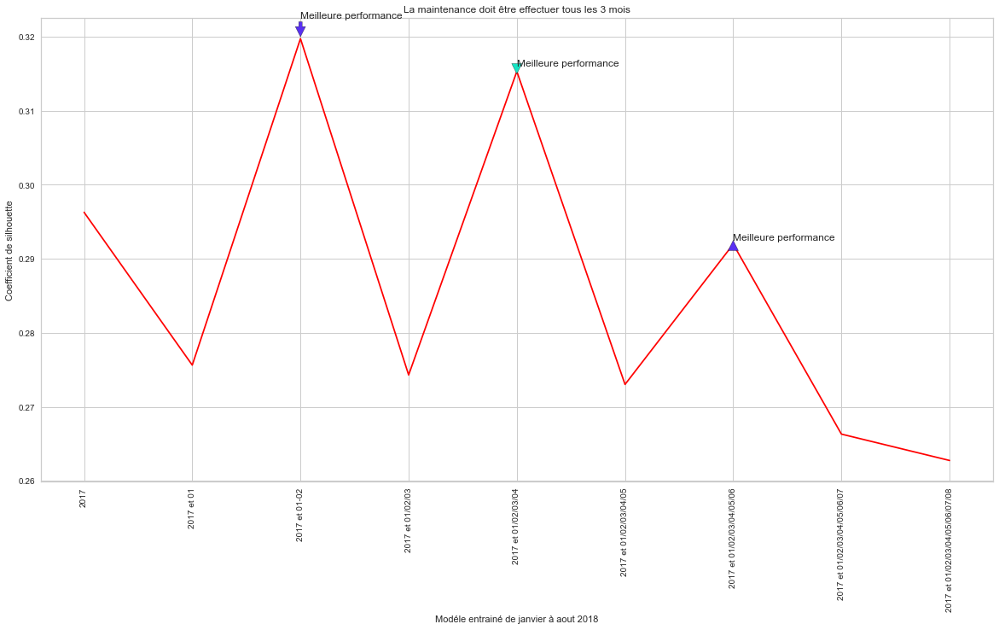

In [266]:
plt.figure(figsize=(20, 10))
plt.plot(df5['Durée'], df5['Silhouette'], c='red')
plt.title('La maintenance doit être effectuer tous les 3 mois')
plt.xlabel('Modéle entrainé de janvier à aout 2018')
plt.ylabel('Coefficient de silhouette')
plt.annotate('Meilleure performance', xy=('2017 et 01-02', 0.32), xytext=('2017 et 01-02', 0.3225),
             arrowprops={'facecolor': '#5930F2'})
plt.annotate('Meilleure performance', xy=('2017 et 01/02/03/04', 0.315), xytext=('2017 et 01/02/03/04', 0.316),
             arrowprops={'facecolor': '#16E4C4'})
plt.annotate('Meilleure performance', xy=('2017 et 01/02/03/04/05/06', 0.2925), xytext=('2017 et 01/02/03/04/05/06', 0.2925),
             arrowprops={'facecolor': '#5930F2'})
plt.xticks(rotation=90)

In [255]:
dataModel.columns

Index(['customer_unique_id', 'Recency', 'Frequence', 'Somme_depenseeLOG',
       'Somme_LivraisonLOG', 'Somme_ProduitLOG', 'Cluster', 'Somme_depense',
       'Somme_Livraison', 'Somme_Produit'],
      dtype='object')

In [253]:
my_clust.cluster_centers_

array([[ 1.06043124, -0.25195598, -0.77117264, -0.52910483, -0.75699452],
       [-0.25643858,  0.60194491,  1.43662119,  1.40729316,  1.33732498],
       [ 0.05239102,  4.98307782,  2.2578638 ,  3.17732642,  1.9639338 ],
       [-0.66314142, -0.18915127,  0.17061866, -0.07932307,  0.21674161],
       [-0.63981893, -0.2668036 , -1.05277077, -0.68590582, -1.06473583],
       [ 1.10882485, -0.08951532,  0.51342048,  0.11887988,  0.54628   ]])